<a href="https://colab.research.google.com/github/CristinaCielma/Segunda-pre-entrega-del-proyecto-final_Arevalo-Cielma/blob/main/TRABAJO_FINAL_Arevalo_Cielma.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Abstracto de motivación y audiencia

En los últimos años, las criptomonedas han tenido una evolución importante en las inversiones de miles de personas a lo largo del mundo, quienes han encontrado a través de estos criptoactivos, un medio de intercambio que permite no sólo hacer transacciones en un mundo tan globalizado sino también encontrar un refugio de valor del dinero ante las variaciones de las monedas a lo largo del tiempo. En los últimos años, los sistemas monetarios tradicionales han tenido una vulnerabilidad importante ante las inseguridades económicas que se plantean en las transacciones y en los modelos macroeconómicos que nos rodean, tanto en países emergentes como no emergentes. 

A través del dataset encontrado, y con diferentes inputs como: fecha, nombre de cripto, precio en USD, market_cap y volumen, podremos analizar la evolución de las operaciones con criptomonedas en el tiempo.

El público de interés, serán todos aquellos inversores que buscan una alternativa al mercado de capitales, que deseen evaluar el rendimiento de estos criptoactivos a lo largo del tiempo, y los posibles pronósticos a futuro y variables de interés que deberán seguir de cerca para evaluar las posibilidades de volcarse a lo mismos, considerando que preferentemente deberán ser inversores de largo plazo, por el tiempo que demanda obtener buenos resultados.


##Preguntas/Hipótesis de interés:

Plantearemos algunas preguntas/hipótesis:

1- ¿Podremos determinar el comportamiento del valor de la cripto a través de su relación con el market_cap y el volumen? 

2- ¿Existen inversiones de largo plazo o corto plazo? ¿Qué tan relevante es determinar esto en la predicción futura?

3- ¿Podremos predecir el valor futuro de las criptomonedas analizadas a partir del comportamiento que revelaron hasta el año 2022? ¿Es importante el market cap y volumen? ¿Afecta en la determinación de la predicción del precio si es una inversión de largo o corto plazo?






Tomaremos el caso de BTC (Bitcoin) y ETH (Ethereum).

#Exploración de datos (EDA)


##Elección DataSet

In [ ]:
#importamos el dataset
!pip install -U -q PyDrive

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

downloaded = drive.CreateFile({'id':"1wYFFMI4n1a-ZN1ft6zlBo1anSpSTpTR-"})
downloaded.GetContentFile('crypto_tradinds.csv')

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt


df_cryp = pd.read_csv("crypto_tradinds.csv", low_memory=False)
df_cryp.head()

,trade_date,volume,price_usd,price_btc,market_cap,capitalization_change_1_day,USD_price_change_1_day,BTC_price_change_1_day,crypto_name,crypto_type,ticker,max_supply,site_url,github_url,minable,platform_name,industry_name
0,2016-01-01,36278900.0,434.33,1.0,6.529300e+09,0.000000,0.000000,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
1,2016-01-02,30096600.0,433.44,1.0,6.517390e+09,-0.001824,-0.002049,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
2,2016-01-03,39633800.0,430.01,1.0,6.467430e+09,-0.007666,-0.007913,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
3,2016-01-04,38477500.0,433.09,1.0,6.515713e+09,0.007466,0.007163,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
4,2016-01-05,34522600.0,431.96,1.0,6.500393e+09,-0.002351,-0.002609,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)


In [ ]:
#Buscamos los valores nulos
df_cryp.isnull()

,trade_date,volume,price_usd,price_btc,market_cap,capitalization_change_1_day,USD_price_change_1_day,BTC_price_change_1_day,crypto_name,crypto_type,ticker,max_supply,site_url,github_url,minable,platform_name,industry_name
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2382638,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True
2382639,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True
2382640,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True
2382641,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True


In [ ]:
df_cryp.isnull().sum().sum()

4862194

In [ ]:
#Reemplazamos por cero los nulos
df_cryp.fillna(0, inplace=True)
df_cryp.head().round(2)

,trade_date,volume,price_usd,price_btc,market_cap,capitalization_change_1_day,USD_price_change_1_day,BTC_price_change_1_day,crypto_name,crypto_type,ticker,max_supply,site_url,github_url,minable,platform_name,industry_name
0,2016-01-01,36278900.0,434.33,1.0,6.529300e+09,0.00,0.00,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
1,2016-01-02,30096600.0,433.44,1.0,6.517390e+09,-0.00,-0.00,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
2,2016-01-03,39633800.0,430.01,1.0,6.467430e+09,-0.01,-0.01,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
3,2016-01-04,38477500.0,433.09,1.0,6.515713e+09,0.01,0.01,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)
4,2016-01-05,34522600.0,431.96,1.0,6.500393e+09,-0.00,-0.00,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW)


In [ ]:
df_cryp.shape

(2382643, 17)

In [ ]:
df_cryp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2382643 entries, 0 to 2382642
Data columns (total 17 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   trade_date                   object 
 1   volume                       float64
 2   price_usd                    float64
 3   price_btc                    float64
 4   market_cap                   float64
 5   capitalization_change_1_day  float64
 6   USD_price_change_1_day       float64
 7   BTC_price_change_1_day       float64
 8   crypto_name                  object 
 9   crypto_type                  float64
 10  ticker                       object 
 11  max_supply                   float64
 12  site_url                     object 
 13  github_url                   object 
 14  minable                      float64
 15  platform_name                object 
 16  industry_name                object 
dtypes: float64(10), object(7)
memory usage: 309.0+ MB


In [ ]:
#De la descripción de datos, lo más relevante es que resulta necesario hacer la transformación a formato fecha
df_cryp['date_f']=pd.DatetimeIndex(pd.to_datetime(df_cryp['trade_date']))
df_cryp.head()

,trade_date,volume,price_usd,price_btc,market_cap,capitalization_change_1_day,USD_price_change_1_day,BTC_price_change_1_day,crypto_name,crypto_type,ticker,max_supply,site_url,github_url,minable,platform_name,industry_name,date_f
0,2016-01-01,36278900.0,434.33,1.0,6.529300e+09,0.000000,0.000000,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW),2016-01-01
1,2016-01-02,30096600.0,433.44,1.0,6.517390e+09,-0.001824,-0.002049,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW),2016-01-02
2,2016-01-03,39633800.0,430.01,1.0,6.467430e+09,-0.007666,-0.007913,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW),2016-01-03
3,2016-01-04,38477500.0,433.09,1.0,6.515713e+09,0.007466,0.007163,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW),2016-01-04
4,2016-01-05,34522600.0,431.96,1.0,6.500393e+09,-0.002351,-0.002609,0.0,Bitcoin,0.0,BTC,21000000.0,https://bitcoin.org/,https://github.com/bitcoin/,1.0,XRP,Proof of Work (PoW),2016-01-05


###Feature Selection

A partir del df obtenido en el paso anterior _df_cryp_, en primera instancia consideramos interesante la relación que podría establecerse entre el precio del BTC y algunas variables que pudieran ser relevantes.

Para nuestro caso elegiremos: 

Volume: Cantidad de operaciones por día

market_cap: valor total de las acciones en circulación de una empresa

price_dia_ant: valor calculado del precio del día anterior, a partir de 

USD_price_change_1_day. 

date_f: lo establecemos como índice.

Sacamos del modelo las variables ticker, ya que en nuestro caso está filtrado sólo para BTC Y USD_price_change_1_day porque es la variable que utilizamos para calcular el precio del día anterior.

In [ ]:
from datetime import datetime, timedelta
df_cr_r=df_cryp[['date_f','volume','price_usd','market_cap','ticker','USD_price_change_1_day']]
df_cr_r.head()

,date_f,volume,price_usd,market_cap,ticker,USD_price_change_1_day
0,2016-01-01,36278900.0,434.33,6.529300e+09,BTC,0.000000
1,2016-01-02,30096600.0,433.44,6.517390e+09,BTC,-0.002049
2,2016-01-03,39633800.0,430.01,6.467430e+09,BTC,-0.007913
3,2016-01-04,38477500.0,433.09,6.515713e+09,BTC,0.007163
4,2016-01-05,34522600.0,431.96,6.500393e+09,BTC,-0.002609


In [ ]:
#Creamos variables que consideramos relevantes para el análisis
df_cr_r['price_dia_ant']=df_cr_r['price_usd']*(1+df_cr_r['USD_price_change_1_day']*(-1))
df_cr_r['variacion_precio']=(df_cr_r['price_usd']-df_cr_r['price_dia_ant'])/(df_cr_r['price_dia_ant'])
df_cr_r.head()

<ipython-input-9-c242018f90c6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cr_r['price_dia_ant']=df_cr_r['price_usd']*(1+df_cr_r['USD_price_change_1_day']*(-1))
<ipython-input-9-c242018f90c6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cr_r['variacion_precio']=(df_cr_r['price_usd']-df_cr_r['price_dia_ant'])/(df_cr_r['price_dia_ant'])


,date_f,volume,price_usd,market_cap,ticker,USD_price_change_1_day,price_dia_ant,variacion_precio
0,2016-01-01,36278900.0,434.33,6.529300e+09,BTC,0.000000,434.330000,0.000000
1,2016-01-02,30096600.0,433.44,6.517390e+09,BTC,-0.002049,434.328176,-0.002045
2,2016-01-03,39633800.0,430.01,6.467430e+09,BTC,-0.007913,433.412857,-0.007851
3,2016-01-04,38477500.0,433.09,6.515713e+09,BTC,0.007163,429.987939,0.007214
4,2016-01-05,34522600.0,431.96,6.500393e+09,BTC,-0.002609,433.087052,-0.002602


##Analizando la API

Agregamos a la información obtenida lo que descargaremos de la API de yahoo finance, sobre la información de los años bajo estudio:

In [ ]:
import requests
import json
import numpy as np
import pandas as pd

In [ ]:
from pandas_datareader import data as pdr

In [ ]:
!pip install yfinance
import yfinance as yf

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 KB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.1/4.1 MB 20.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 KB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.2/112.2 KB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.0/111.0 KB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.2/128.2 KB 13.7 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.25.1
    Uninstalling requests-2.25.1:
      Successfully uninstalled requests-2.25.1
  Attempting uninstall: html5lib
    Found existing installation: html5lib 1.0.1
    Uninstalling html5lib-1.0.1:
      Successfully uninstalled html5lib-1.0.1
  Attempting uninstall: beautifulsoup4
    Found existing installation: beautifulsoup4 4.6.3
   

Procedemos a rescatar la info de BTC, ETH y USDT tanto del dataset como de la API para poder hacer los join correspondientes y analizar la información que hemos obtenido:


##BTC

Bitcoin es una moneda que, a diferencia de las monedas tradicionales que tiene cada país, es electrónica y no es física, por lo que las transacciones siempre se realizan en línea.

Como se trata de la primera divisa digital que apareció en el mercado y se mantuvo en el tiempo es una de las mas confiables.

Analizaremos el caso de BTC, para lo cual primero ejecutaremos la tabla a través de la API de Yahoo Finance, exploraremos los valores nulos y duplicados y descubriremos los valores percibidos.

#### Feature Engineering BTC

In [ ]:
df_cr_reg_bit=df_cr_r.query("ticker=='BTC'")
df_cr_reg_bit.head()

,date_f,volume,price_usd,market_cap,ticker,USD_price_change_1_day,price_dia_ant,variacion_precio
0,2016-01-01,36278900.0,434.33,6.529300e+09,BTC,0.000000,434.330000,0.000000
1,2016-01-02,30096600.0,433.44,6.517390e+09,BTC,-0.002049,434.328176,-0.002045
2,2016-01-03,39633800.0,430.01,6.467430e+09,BTC,-0.007913,433.412857,-0.007851
3,2016-01-04,38477500.0,433.09,6.515713e+09,BTC,0.007163,429.987939,0.007214
4,2016-01-05,34522600.0,431.96,6.500393e+09,BTC,-0.002609,433.087052,-0.002602


In [ ]:
df_cr_r_bit=df_cr_reg_bit[['date_f','volume','price_usd','market_cap','price_dia_ant']]
df_cr_r_bit= df_cr_r_bit.set_index('date_f')
df_cr_r_bit.sort_index(inplace=True)
df_cr_r_bit.head()

,volume,price_usd,market_cap,price_dia_ant
date_f,,,,
2016-01-01,36278900.0,434.33,6.529300e+09,434.330000
2016-01-02,30096600.0,433.44,6.517390e+09,434.328176
2016-01-03,39633800.0,430.01,6.467430e+09,433.412857
2016-01-04,38477500.0,433.09,6.515713e+09,429.987939
2016-01-05,34522600.0,431.96,6.500393e+09,433.087052


In [ ]:
#Analizaremos el caso del market_cap. Importamos una clase para manejar las marcas de los ejes en formato de fechas
import numpy as np
import bokeh
from bokeh.io import output_notebook, show, reset_output 
from bokeh.palettes import Spectral6 
from bokeh.models import ColumnDataSource, FactorRange, CategoricalColorMapper 
from bokeh.plotting import figure 
from bokeh.models import HoverTool 

from bokeh.io import show, output_file
from bokeh.plotting import figure
from bokeh.models import DatetimeTickFormatter

# Convertimos las columna Data a marcas de tiempo
df_cr_reg_bit.date_f= pd.to_datetime(df_cr_reg_bit.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Volumen',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot.line(df_cr_reg_bit.date_f, df_cr_reg_bit['volume'], legend_label='Volume', line_width=2)


# Personalizamos el eje X
line_plot.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot.add_tools(HoverTool())
line_plot.legend.location = "top_left"
show(line_plot)

In [ ]:
#Analizaremos el caso del volume.Importamos una clase para manejar las marcas de los ejes en formato de fechas
import bokeh
from bokeh.io import output_notebook, show, reset_output 
from bokeh.palettes import Spectral6 
from bokeh.models import ColumnDataSource, FactorRange, CategoricalColorMapper 
from bokeh.plotting import figure 
from bokeh.models import HoverTool 
import numpy as np
from bokeh.io import show, output_file
from bokeh.plotting import figure
from bokeh.models import DatetimeTickFormatter

# Convertimos las columna Data a marcas de tiempo
df_cr_reg_bit.date_f= pd.to_datetime(df_cr_reg_bit.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='market_cap',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot.line(df_cr_reg_bit.date_f, df_cr_reg_bit['market_cap'], legend_label='market_cap', line_width=2)


# Personalizamos el eje X
line_plot.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot.add_tools(HoverTool())
line_plot.legend.location = "top_left"
show(line_plot)

Si bien las escalas son distintas, esta es una primera aproximación del comportamiento del BTC en los inversores. En en año 2018 el market cap tuvo un repunte importante, sin embargo el volumen operado aumentaba pero no al mismo ritmo. Esto pudo haber generado mayor valor de la inversión entre los tenedores de ese momento, que poco a poco fueron incrementándose, por lo cual podemos suponer que si el precio aumentó pero no al mismo ritmo que el volumen, el market cap tuvo un ritmo oscilante.

Será necesario, seguir investigando la relación del precio de la cripto con estas dos variables para determinar si son relevantes en la determinación de su precio. Podríamos suponer por ley de oferta y demanda que un mayor volumen operado (Demanda) implica un mayor precio, afectando a los niveles de market_Cap, pero sería una hipótesis preliminar, que nos determinaría si estas dos variables son relevantes o no en el establecimiento de los precios. 

Exploraremos para el caso de la API en el período de 2016 a 2022, si existen nulos, o valores duplicados que deban normalizarse. 

In [ ]:
yf.pdr_override() 
df_BTC = pdr.get_data_yahoo("BTC-USD", start="2016-01-01", end="2022-09-30")

[*********************100%***********************]  1 of 1 completed


In [ ]:
df_BTC.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2016-01-01,430.721008,436.246002,427.515015,434.334015,434.334015,36278900
2016-01-02,434.622009,436.062012,431.869995,433.437988,433.437988,30096600
2016-01-03,433.578003,433.743011,424.705994,430.010986,430.010986,39633800
2016-01-04,430.061005,434.516998,429.084015,433.091003,433.091003,38477500
2016-01-05,433.069000,434.182007,429.675995,431.959991,431.959991,34522600


In [ ]:
df_BTC.duplicated()

Date
2016-01-01    False
2016-01-02    False
2016-01-03    False
2016-01-04    False
2016-01-05    False
              ...  
2022-09-25    False
2022-09-26    False
2022-09-27    False
2022-09-28    False
2022-09-29    False
Length: 2464, dtype: bool

In [ ]:
df_BTC.duplicated().sum().sum()

0

In [ ]:
df_BTC.isnull()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2016-01-01,False,False,False,False,False,False
2016-01-02,False,False,False,False,False,False
2016-01-03,False,False,False,False,False,False
2016-01-04,False,False,False,False,False,False
2016-01-05,False,False,False,False,False,False
...,...,...,...,...,...,...
2022-09-25,False,False,False,False,False,False
2022-09-26,False,False,False,False,False,False
2022-09-27,False,False,False,False,False,False


In [ ]:
df_BTC.isnull().sum().sum()

0

In [ ]:
df_BTC.isnull().sum(axis=1)

Date
2016-01-01    0
2016-01-02    0
2016-01-03    0
2016-01-04    0
2016-01-05    0
             ..
2022-09-25    0
2022-09-26    0
2022-09-27    0
2022-09-28    0
2022-09-29    0
Length: 2464, dtype: int64

In [ ]:
df_BTC.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2464 entries, 2016-01-01 to 2022-09-29
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       2464 non-null   float64
 1   High       2464 non-null   float64
 2   Low        2464 non-null   float64
 3   Close      2464 non-null   float64
 4   Adj Close  2464 non-null   float64
 5   Volume     2464 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 134.8 KB


In [ ]:
df_BTC['date_f']=df_BTC.index

In [ ]:
df_BTC.head()

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2016-01-01,430.721008,436.246002,427.515015,434.334015,434.334015,36278900,2016-01-01
2016-01-02,434.622009,436.062012,431.869995,433.437988,433.437988,30096600,2016-01-02
2016-01-03,433.578003,433.743011,424.705994,430.010986,430.010986,39633800,2016-01-03
2016-01-04,430.061005,434.516998,429.084015,433.091003,433.091003,38477500,2016-01-04
2016-01-05,433.069000,434.182007,429.675995,431.959991,431.959991,34522600,2016-01-05


####Uniendo API y Data Set

In [ ]:
BTC=pd.merge(df_cr_reg_bit, df_BTC, how='inner', on='date_f')[['date_f','market_cap','price_dia_ant','variacion_precio','Open','High','Low','Close','Adj Close','Volume']]
BTC

,date_f,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
0,2016-01-01,6.529300e+09,434.330000,0.000000,430.721008,436.246002,427.515015,434.334015,434.334015,36278900
1,2016-01-02,6.517390e+09,434.328176,-0.002045,434.622009,436.062012,431.869995,433.437988,433.437988,30096600
2,2016-01-03,6.467430e+09,433.412857,-0.007851,433.578003,433.743011,424.705994,430.010986,430.010986,39633800
3,2016-01-04,6.515713e+09,429.987939,0.007214,430.061005,434.516998,429.084015,433.091003,433.091003,38477500
4,2016-01-05,6.500393e+09,433.087052,-0.002602,433.069000,434.182007,429.675995,431.959991,431.959991,34522600
...,...,...,...,...,...,...,...,...,...,...
1741,2020-10-29,2.489953e+11,13269.198852,0.012712,13271.298828,13612.047852,12980.059570,13437.882812,13437.882812,56499499598
1742,2020-10-30,2.510182e+11,13437.001688,0.008151,13437.874023,13651.516602,13136.198242,13546.522461,13546.522461,30581485201
1743,2020-10-31,2.553721e+11,13542.461675,0.017613,13546.532227,14028.213867,13457.530273,13780.995117,13780.995117,30306464719
1744,2020-11-01,2.545698e+11,13780.850282,-0.003174,13780.995117,13862.033203,13628.377930,13737.109375,13737.109375,24453857900


In [ ]:
BTC_I=BTC.set_index('date_f')
BTC_I

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
date_f,,,,,,,,,
2016-01-01,6.529300e+09,434.330000,0.000000,430.721008,436.246002,427.515015,434.334015,434.334015,36278900
2016-01-02,6.517390e+09,434.328176,-0.002045,434.622009,436.062012,431.869995,433.437988,433.437988,30096600
2016-01-03,6.467430e+09,433.412857,-0.007851,433.578003,433.743011,424.705994,430.010986,430.010986,39633800
2016-01-04,6.515713e+09,429.987939,0.007214,430.061005,434.516998,429.084015,433.091003,433.091003,38477500
2016-01-05,6.500393e+09,433.087052,-0.002602,433.069000,434.182007,429.675995,431.959991,431.959991,34522600
...,...,...,...,...,...,...,...,...,...
2020-10-29,2.489953e+11,13269.198852,0.012712,13271.298828,13612.047852,12980.059570,13437.882812,13437.882812,56499499598
2020-10-30,2.510182e+11,13437.001688,0.008151,13437.874023,13651.516602,13136.198242,13546.522461,13546.522461,30581485201
2020-10-31,2.553721e+11,13542.461675,0.017613,13546.532227,14028.213867,13457.530273,13780.995117,13780.995117,30306464719




Debemos tener presente que trabajar con un join de ambos data set, nos limitará el análisis temporal, ya que el dataset original contiene menos información que la que podemos obtener de la API de Yahoo. 

In [ ]:
# Convertimos las columna Data a marcas de tiempo
BTC.date_f= pd.to_datetime(BTC.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot_2 = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Precio',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot_2.line(BTC.date_f, BTC['Open'], legend_label='Open', line_width=2)
line_plot_2.line(BTC.date_f, BTC['High'], legend_label='High', line_width=2,color='red')
line_plot_2.line(BTC.date_f, BTC['Low'], legend_label='Low', line_width=2,color='green')
line_plot_2.line(BTC.date_f, BTC['Close'], legend_label='Close', line_width=2,color='orange')

# Personalizamos el eje X
line_plot_2.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot_2.add_tools(HoverTool())
line_plot_2.legend.location = "top_left"
show(line_plot_2)

Podemos observar que a simple vista, por más que las escalas sean diferentes, el precio pareciera tener una dirección más acorde al market_cap que al volumen.

Vamos a analizar con mayor profundidad el caso del precio de cierre y el precio del día anterior:

In [ ]:
# Convertimos las columna Data a marcas de tiempo
BTC.date_f= pd.to_datetime(BTC.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot_3 = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Precio',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot_3.line(BTC.date_f, BTC['price_dia_ant'], legend_label='Precio dia ant', line_width=2)
line_plot_3.line(BTC.date_f, BTC['Close'], legend_label='Close', line_width=2,color='orange')

# Personalizamos el eje X
line_plot_3.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot_3.add_tools(HoverTool())
line_plot_3.legend.location = "top_left"
show(line_plot_3)

En general, no vemos una variación importante de un día al otro. Lo confirmaremos con el gráfico de variación:

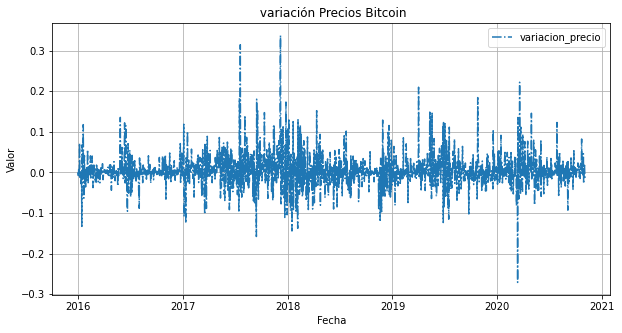

In [ ]:
BTC_I['Date']=BTC_I.index
BTC_I.head()


fig,ax= plt.subplots(figsize=(10,5))
ax.plot(BTC_I.Date, BTC_I.variacion_precio, label='variacion_precio',linewidth=1.5,linestyle='-.' )

ax.legend()
ax.grid()
ax.set_title(' variación Precios Bitcoin')
ax.set_xlabel('Fecha')
ax.set_ylabel('Valor')
plt.show()

En el gráfico de variación sí podemos observar algunas variaciones importantes de un día al otro en el año 2020 hacia mínimos, probablemente relacionado a los primeros meses de pandemia y luego máximos mostrando una recuperación y en 2017 mostrando el primer repunte en el valor de la cripto.

Analizaremos las correlaciones entre las distintas variables:

In [ ]:
BTC_I.corr()

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
market_cap,1.000000,0.994953,0.029225,0.994876,0.995585,0.997729,0.997956,0.997956,0.688963
price_dia_ant,0.994953,1.000000,-0.035308,0.999938,0.998145,0.997796,0.996787,0.996787,0.655138
variacion_precio,0.029225,-0.035308,1.000000,-0.034123,0.003429,0.001439,0.032179,0.032179,0.024630
Open,0.994876,0.999938,-0.034123,1.000000,0.998479,0.997543,0.996862,0.996862,0.655403
High,0.995585,0.998145,0.003429,0.998479,1.000000,0.996850,0.998607,0.998607,0.655018
Low,0.997729,0.997796,0.001439,0.997543,0.996850,1.000000,0.998321,0.998321,0.658822
Close,0.997956,0.996787,0.032179,0.996862,0.998607,0.998321,1.000000,1.000000,0.656629
Adj Close,0.997956,0.996787,0.032179,0.996862,0.998607,0.998321,1.000000,1.000000,0.656629
Volume,0.688963,0.655138,0.024630,0.655403,0.655018,0.658822,0.656629,0.656629,1.000000


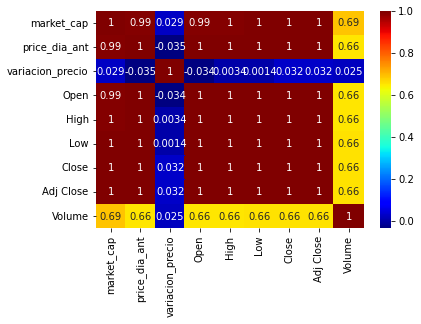

In [ ]:
sns.heatmap(BTC_I.corr(),annot=True,cmap='jet')
plt.show()

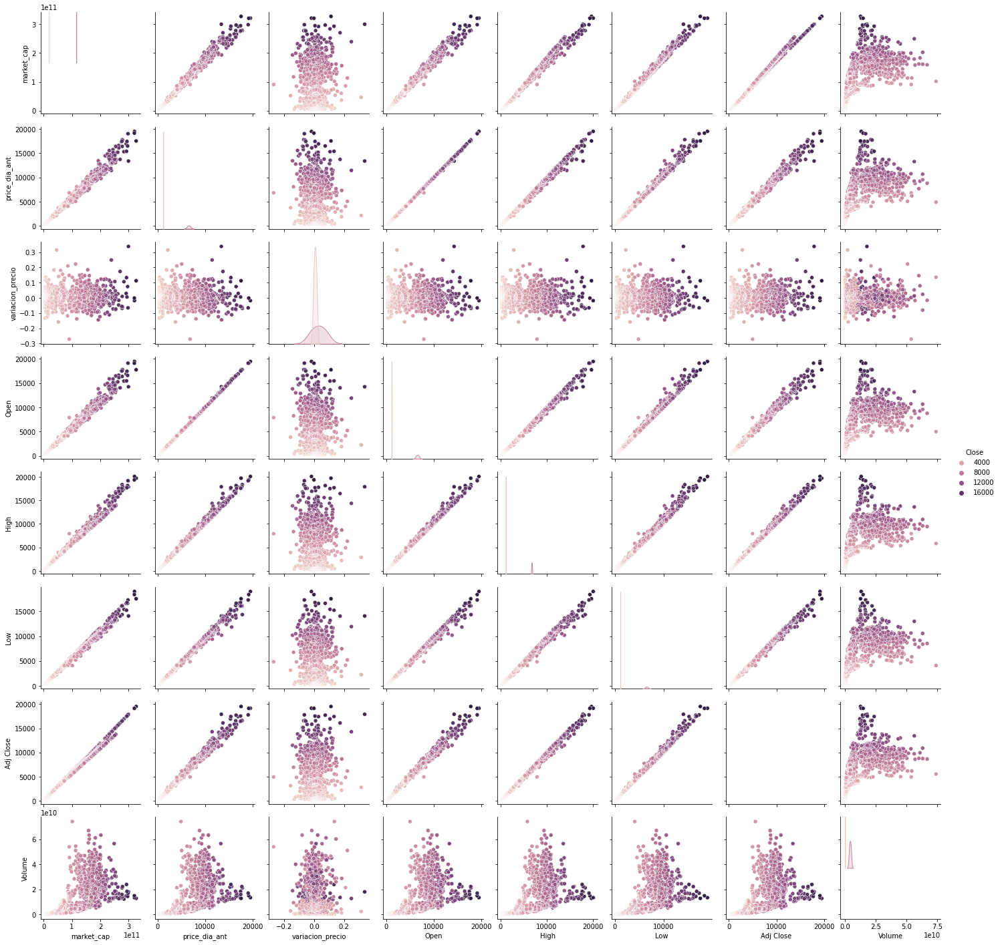

In [ ]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from seaborn.relational import lineplot 

sns.pairplot(BTC_I,hue='Close')

En general, podemos observar que la variable que menos se correlaciona con todas es la variación en el precio, esto tiene que ver con que los datos no están normalizados. Pero como pudimos calcular el precio del día anterior, podemos considerar a esta variable como desechable. Luego el volumen, por lo cual probablemente la cantidad operada de la moneda no tiene una relación tan significativa con los precios operados. 

**Moving Average**

Muestra el valor medio del precio de un instrumento durante un determinado período de tiempo. Cuando se calcula Moving Average, se promedia matemáticamente el precio del instrumento durante un período de tiempo dado. En función del cambio del precio, su valor medio va aumentando o disminuyendo. Es un indicador para el mercado de en qué momentos comprar o vender. El modo más común de interpretar la media móvil del precio consiste en la comparación de su dinámica con la dinámica del mismo precio. Cuando el precio del instrumento financiero sube por encima del valor de la Media Móvil, aparece la señal de compra, cuando baja de la línea del indicador – salta la señal de venta.

Intentaremos establecer que si se alternan los momentos de venta y compra en períodos más prolongados, probablemente sea una inversión de largo plazo.

Text(0.5, 1.0, 'Bitcoin Close Price moving average')

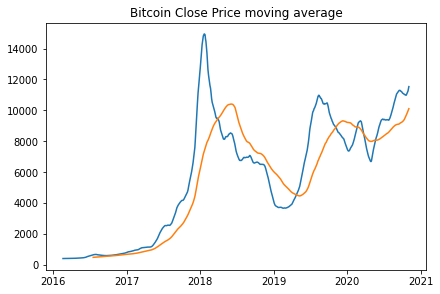

In [ ]:
fig = plt.figure(figsize = (15,10))

plt.subplot(2, 2, 1)
plt.plot(BTC['date_f'], BTC['Close'].rolling(50).mean())
plt.plot(BTC['date_f'], BTC['Close'].rolling(200).mean())
plt.title('Bitcoin Close Price moving average')

Vemos cómo la media móvil oscila con el precio y corta a la línea del valor real en pocos momentos a lo largo de todos los años bajo estudio. Por lo tanto esta conclusión nos lleva a pensar que es una inversión de largo plazo. 

Text(5000, 400, 'Bitcoin Close Price')

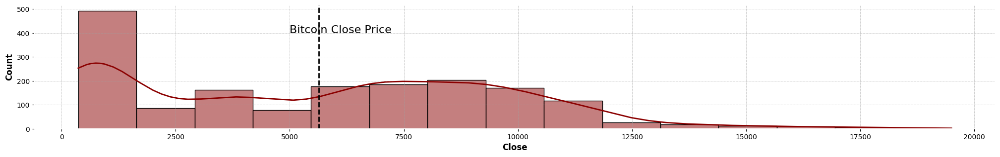

In [ ]:
fig = plt.figure(figsize = (25,15))

fig.tight_layout()

plt.subplot(4, 1, 1)
sns.histplot(BTC['Close'],color='darkred', kde=True)
plt.axvline(BTC['Close'].mean(), color='k', linestyle='dashed', linewidth=2)
plt.text(5000,400,'Bitcoin Close Price', fontsize=16)

Analizamos el precio de cierre y vemos que la mayoría de los valores en promedio se han ubicado el precios entre cero y 10.000

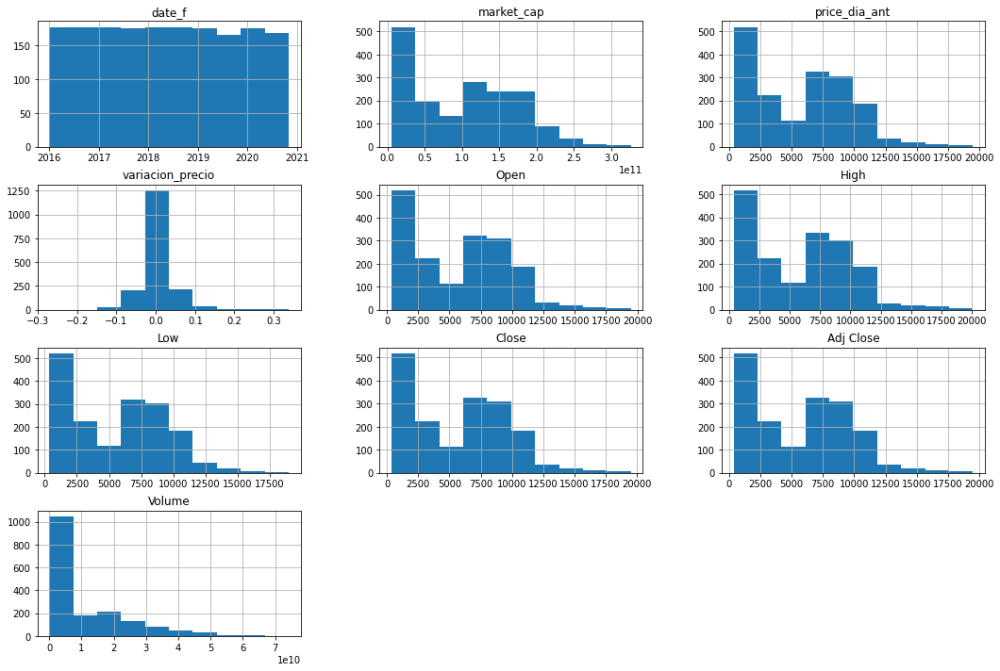

In [ ]:
bit_numeric = BTC.select_dtypes(exclude = ["bool"])
bit_numeric.hist(figsize=(18,12))
plt.show()

Los precios en el período analizado, presentan un comportamiento asimétrico, estando más sesgados a valores entre 0 y 2500 USD. El caso de la variación en el precio presenta una distribución normal, y el volumen pareciera ser bastante asimétrico y con valores muy altos o muy bajos. 

In [ ]:
BTC_I.describe()

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
count,1.746000e+03,1746.000000,1746.000000,1746.000000,1746.000000,1746.000000,1746.000000,1746.000000,1.746000e+03
mean,9.882215e+10,5612.721617,0.004439,5623.504944,5765.173384,5474.669890,5631.836033,5631.836033,1.057376e+10
std,7.238476e+10,4041.892921,0.040404,4052.164046,4172.117745,3914.390312,4055.896532,4055.896532,1.281451e+10
min,5.496598e+09,362.851384,-0.270975,365.072998,374.950012,354.914001,364.330994,364.330994,2.851400e+07
25%,1.831971e+10,1117.442707,-0.011033,1121.940033,1161.432526,1101.150024,1126.897522,1126.897522,2.777012e+08
50%,1.083556e+11,6241.563909,0.002070,6246.562256,6381.157715,6113.433838,6252.710205,6252.710205,5.004655e+09
75%,1.577908e+11,8819.613890,0.017620,8834.371582,9044.385254,8661.263428,8833.977051,8833.977051,1.736732e+10
max,3.265025e+11,19490.877922,0.337742,19475.800781,20089.000000,18974.099609,19497.400391,19497.400391,7.415677e+10


En primera instancia, podemos observar que los precios promedio de apertura, cierre, máximos, mínimos se mantienen en el umbral de 5474 a 5765 con desviaciones estándar que rondan los 4000. Al ser menor la desviación que la media, podríamos establecer en principio que los datos no tienen tanta "dispersión" en torno a la media.

Todo el análisis de estas variables nos permitirá establecer qué tan robustos pueden ser los datos con los que contemos para establecer predicciones futuras.

Por otro lado observamos que los máximos y mínimos se encuentran bastante alejadosde los límites superiores e inferiores, sobre todo los máximos, rondando en valores cercanos a 20.000 cuando los LS rondan valores de 9.000, lo cual nos haría pensar que en todo el período analizado, puede que no hayan existido grandes desviaciones, pero cuando las hubieron fueron más por encima de la media que por debajo.



####¿Es el BTC una inversión de Corto o Largo Plazo?

A partir de lo observado podemos suponer que se trata de una inversión de Largo Plazo:

In [ ]:
#Analizando la evolución del precio de cierre
BTC_I_close=BTC_I[['Close']]
BTC_I_close.head()

,Close
date_f,
2016-01-01,434.334015
2016-01-02,433.437988
2016-01-03,430.010986
2016-01-04,433.091003
2016-01-05,431.959991


In [ ]:
BTC_I_close['Date_2']=BTC_I_close.index
BTC_I_close

<ipython-input-40-a9461c2bdff1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  BTC_I_close['Date_2']=BTC_I_close.index


,Close,Date_2
date_f,,
2016-01-01,434.334015,2016-01-01
2016-01-02,433.437988,2016-01-02
2016-01-03,430.010986,2016-01-03
2016-01-04,433.091003,2016-01-04
2016-01-05,431.959991,2016-01-05
...,...,...
2020-10-29,13437.882812,2020-10-29
2020-10-30,13546.522461,2020-10-30
2020-10-31,13780.995117,2020-10-31


In [ ]:
import plotly.graph_objects as go # importamos los objetos de plotly
import plotly.express as px

fig_BTC=px.line(data_frame=BTC_I_close, x='Date_2',y='Close',title='Precio BTC', 
                 labels={"Date_2":"Fecha", "Close":"Precio"})
fig_BTC.update_layout(paper_bgcolor="#FFFFFa",plot_bgcolor='#FFFFFa',)

fig_BTC.show()

Los mayores valores se observan en períodos largos de tiempo. Incluso sabiendo cómo se ha comportado BTC en períodos posteriores al analizado, hasta la fecha comprobamos que los valores máximos alcanzados fueron mayores al máximo que podemos observar en 2017 dado el dataset que nos limita obtener más información.

Analizaremos lo mismo, para el caso de los datos de la API.


In [ ]:
df_BTC_close=df_BTC[['Close','date_f']]
df_BTC_close

,Close,date_f
Date,,
2016-01-01,434.334015,2016-01-01
2016-01-02,433.437988,2016-01-02
2016-01-03,430.010986,2016-01-03
2016-01-04,433.091003,2016-01-04
2016-01-05,431.959991,2016-01-05
...,...,...
2022-09-25,18802.097656,2022-09-25
2022-09-26,19222.671875,2022-09-26
2022-09-27,19110.546875,2022-09-27


In [ ]:
import plotly.graph_objects as go # importamos los objetos de plotly
import plotly.express as px

fig_BTC=px.line(data_frame=df_BTC_close, x='date_f',y='Close',title='Precio BTC', 
                 labels={"date_f":"Fecha", "Close":"Precio"})
fig_BTC.update_layout(paper_bgcolor="#FFFFFa",plot_bgcolor='#FFFFFa',)

fig_BTC.show()

Vemos como ampliando la serie, a través de los datos de la API, los valores máximos se dieron a finales de 2021.

Observaremos con mayor detenimiento este comportamiento en los últimos 100 días, teniendo en cuenta el típico gráfico de velas que se utiliza para activos financieros.

In [ ]:
!pip install mplfinance
from pandas_datareader import data as pdr
from datetime import datetime, timedelta
import mplfinance as mpf




Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.1/73.1 KB 3.1 MB/s eta 0:00:00


In [ ]:
init_date=datetime.now()-timedelta(days=100)
print("FECHA DE INICIO: ", init_date)

FECHA DE INICIO:  2022-10-02 21:59:53.452650


In [ ]:
df_in= pdr.get_data_yahoo("BTC-USD", start=init_date)
print(df_in.head(10))

[*********************100%***********************]  1 of 1 completed
                    Open          High           Low         Close  \
Date                                                                 
2022-10-02  19311.849609  19370.308594  18970.621094  19044.107422   
2022-10-03  19044.068359  19653.542969  19025.226562  19623.580078   
2022-10-04  19623.583984  20380.343750  19523.839844  20336.843750   
2022-10-05  20335.900391  20343.748047  19801.800781  20160.716797   
2022-10-06  20161.039062  20408.392578  19900.087891  19955.443359   
2022-10-07  19957.558594  20041.085938  19395.792969  19546.849609   
2022-10-08  19546.328125  19601.695312  19299.414062  19416.568359   
2022-10-09  19417.478516  19542.539062  19349.259766  19446.425781   
2022-10-10  19446.416016  19515.466797  19102.978516  19141.484375   
2022-10-11  19139.000000  19241.960938  18925.603516  19051.417969   

               Adj Close       Volume  
Date                                   
2022-10-02

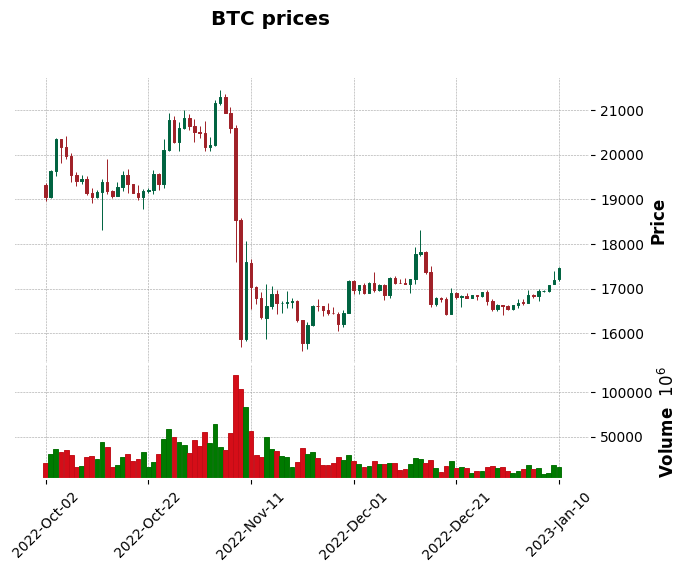

In [ ]:
mpf.plot(df_in, type='candle', title='BTC prices',volume=True, style='charles')

En este caso, podemos observar como en el año 2022 los precios han disminuido notablemente. No sería conveniente dejar fuera del análisis estos valores que podrían aportar información significativa a los modelos. 

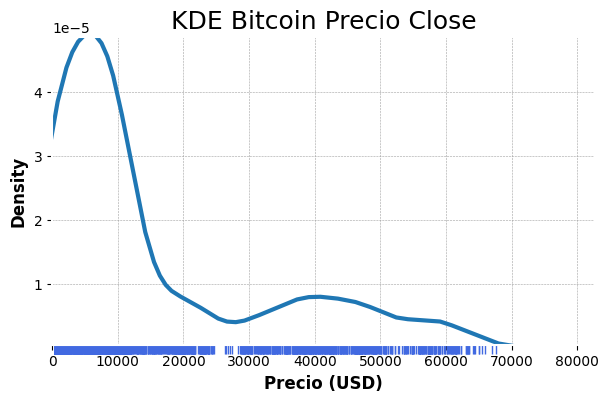

In [ ]:
fig, ax = plt.subplots(figsize=(7, 4))
p = sns.kdeplot(data=df_BTC_close, x='Close', linewidth=3, ax=ax)
r = sns.rugplot(data=df_BTC_close, x='Close', ax=ax, c='royalblue',
                height=-.03, clip_on=False)
p.set(xlim=(0, None))
p.set_title('KDE Bitcoin Precio Close', fontsize=18)
p.set_xlabel('Precio (USD)');

En los datos de estudio se observa una distribución mayoritaria de precios por debajo de los 20.000 (USD). Esta etapa corresponde al periodo entre el año 2016 y septiembre de 2020. En cambio, desde 2021, el precio se ha situado en la zona de los 35.000 - 67.500 (USD).

Tratar de modelar una serie temporal con una distribución muy asimétrica y distintos órdenes de magnitud a lo largo del tiempo puede ser complicado. 

In [ ]:
# Analizaremos las variaciones por año. Se localizan los datos correspondientes para cada año para el caso de los datos de la API
# ==============================================================================
years = list(df_BTC.index.year.unique())
df_plot = pd.DataFrame()

for year in years:
    
    year_open  = df_BTC.loc[df_BTC.index.year == year, 'Open'][0]
    year_close = df_BTC.loc[df_BTC.index.year == year, 'Close'][-1]
    year_low   = df_BTC.loc[df_BTC.index.year == year, 'Low'].min()
    year_high  = df_BTC.loc[df_BTC.index.year == year, 'High'].max()
    
    df_plot[year] = pd.Series([year_open, year_close, year_low, year_high]) 
    
df_plot = df_plot.T
df_plot = df_plot.set_axis(['Open', 'Close', 'Low', 'High'], axis=1)

# Se calcula el % de cambio entre el open y el close del año
# ==============================================================================
df_plot['year_change'] = 100*(df_plot['Close'] - df_plot['Open']) / df_plot['Open']
df_plot.head(7)

,Open,Close,Low,High,year_change
2016,430.721008,963.742981,354.914001,979.396973,123.751097
2017,963.658020,14156.400391,755.755981,20089.000000,1369.027404
2018,14112.200195,3742.700439,3191.303467,17712.400391,-73.478973
2019,3746.713379,7193.599121,3391.023682,13796.489258,91.997583
2020,7194.892090,29001.720703,4106.980957,29244.876953,303.087640
2021,28994.009766,46306.445312,28722.755859,68789.625000,59.710387
2022,46311.746094,19573.050781,17708.623047,48086.835938,-57.736314


In [ ]:
# Se crea una lista de dicts con las anotaciones de % de cambio para el gráfico
# ==============================================================================
annotations_list = []
max_high = df_plot['High'].max()

for year in years:
    
    df_aux = df_plot.loc[df_plot.index == year,]
    loc_x  = pd.to_datetime(df_aux.index[0], format='%Y')
    loc_y  = df_aux['High'].values[0]/max_high + 0.05
    text   = '{:.1f}%'.format(df_aux['year_change'].values[0])
    
    annotation = dict(x=loc_x, y=loc_y, 
                      xref='x', yref='paper',
                      showarrow=False, xanchor='center', 
                      text=text)

    annotations_list.append(annotation)

# Gráfico de velas japonesas anual interactivo con Plotly
# ==============================================================================
fig = go.Figure(data=[go.Candlestick(x= pd.to_datetime(df_plot.index, format='%Y'),
                  open  = df_plot.Open,
                  close = df_plot.Close,
                  low   = df_plot.Low,
                  high  = df_plot.High)])



fig.update_layout(
    width       = 800,
    height      = 350,
    title       = dict(text='<b>Chart Bitcoin/USD por año</b>', font=dict(size=25)),
    yaxis_title = dict(text='Precio (USD)', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    xaxis_rangeslider_visible = False,
    annotations = annotations_list
)

fig.show()

Todas las variaciones en el precio, nos lleva a determinar que es una inversión de largo plazo, en la cual el inversor debe ser paciente para obtener beneficios. Teniendo en cuenta esto, es importante no dejar afuera ningún dato para la construcción de modelos de ML. 

**Feature Selection**

Con los datos analizados en EDA, llegamos a la conclusión que será más importante para el análisis considerar datos de un mayor período de tiempo. Para ello deberemos quedarnos con los datos proporcionados por la API, teniendo en cuenta que la mayoría de las variables que quedan fuera del análisis no tienen una fuerte correlación con el precio, por lo cual descartarlas en principio no afectaría el análisis. 

Analizaremos la media móvil y la variación del precio para el período considerado en la API.



Text(0.5, 1.0, 'Bitcoin Close Price moving average')

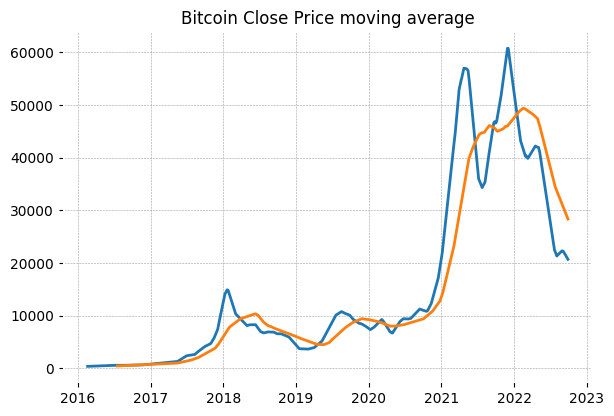

In [ ]:
fig = plt.figure(figsize = (15,10))

plt.subplot(2, 2, 1)
plt.plot(df_BTC['date_f'], df_BTC['Close'].rolling(50).mean())
plt.plot(df_BTC['date_f'], df_BTC['Close'].rolling(200).mean())
plt.title('Bitcoin Close Price moving average')

Vemos cómo la media móvil oscila en mayor medida al considerar las variables de la API, y un mayor período de tiempo. 

Text(50000, 400, 'Bitcoin Close Price')

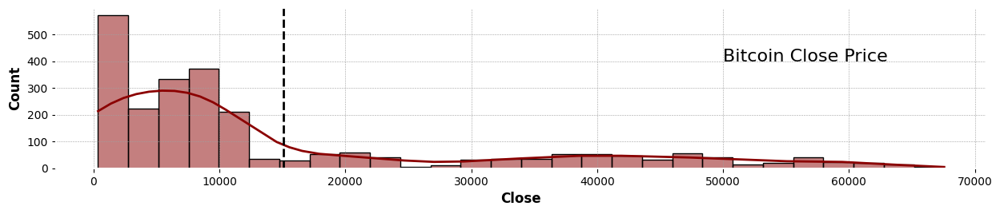

In [ ]:
fig = plt.figure(figsize = (15,12))

fig.tight_layout()

plt.subplot(4, 1, 1)
sns.histplot(df_BTC['Close'],color='darkred', kde=True)
plt.axvline(df_BTC['Close'].mean(), color='k', linestyle='dashed', linewidth=2)
plt.text(50000,400,'Bitcoin Close Price', fontsize=16)

Analizamos el precio de cierre y vemos que la mayoría de los valores en promedio se han ubicado el precios entre cero y 10.000, lo cual amplía los resultados.

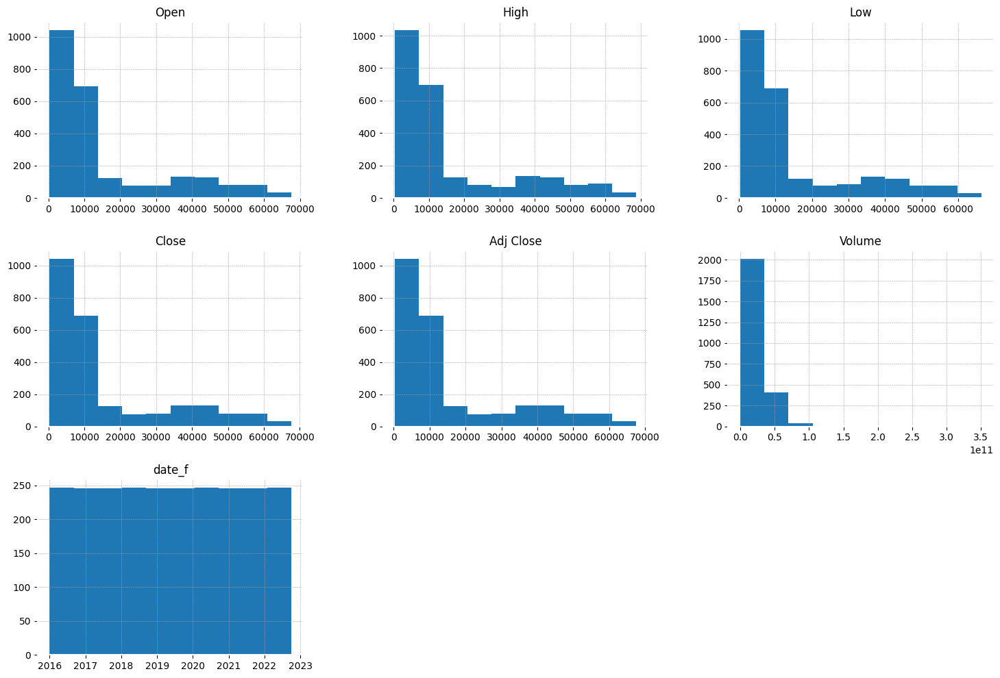

In [ ]:
bit_numeric = df_BTC.select_dtypes(exclude = ["bool"])
bit_numeric.hist(figsize=(18,12))
plt.show()

###¿Podremos predecir el valor futuro?



####**MODELO 1: REGRESIÓN**: 

Utilizaremos los valores de la API, según las conclusiones a las que pudimos llegar en los pasos anteriores.

In [ ]:
#comenzamos estableciendo los valores con una regresión simplre
import pandas as pd
from scipy import stats
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
from bokeh.resources import INLINE
import bokeh.io
from bokeh import *
bokeh.io.output_notebook(INLINE)
# var dep ~ vars indepen, + añade nuevas columnas
model1 = 'Close~Open+High+Low+Volume' 
# crea un modelo/regresión para las variables y se ajusta con .fit()
lm1 = smf.ols(formula = model1, data = df_BTC).fit()
# se presenta un resumen de los residuos del modelo
print(lm1.summary()) 
# OLS es ordinary least squares

                            OLS Regression Results                            
Dep. Variable:                  Close   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.311e+06
Date:                Tue, 10 Jan 2023   Prob (F-statistic):               0.00
Time:                        21:59:57   Log-Likelihood:                -18039.
No. Observations:                2464   AIC:                         3.609e+04
Df Residuals:                    2459   BIC:                         3.612e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      1.1496     10.523      0.109      0.9

Variable dependiente es 'price_usd', usamos OLS conocidos como mínimos cuadrados ordinarios.

El número de observaciones es significativo. Df Residuals es otro nombre para nuestros Grados de Libertad en nuestro modo.

Df model es el número de nuestras variables de predicción (Open, High, Low, Volume).

Nuestro tipo de covarianza aparece como no robusto. Una covarianza robusta es aquella que se calcula de manera que se minimicen o eliminen las variables, lo que no es el caso aquí.

R-squared es la medida de cuánto de la variable dependiente se explica por cambios en nuestras variables independientes. En términos porcentuales, 0,999 significaría que nuestro modelo explica el 99.9% del cambio en nuestra variable 'Close'.

El Adj R-squared penaliza la fórmula R-squared en función del número de variables, por lo tanto, una puntuación ajustada más baja puede indicarle que algunas variables no están contribuyendo correctamente al R-squared de su modelo.En nuestro caso esto no sucede ya que el valor es igual al 99,9%

Según este modelo, el precio de cierre del bitcoin tiene una relación positiva con el precio Low, High y Volume pero negativa con Open.

A partir de nuestra fórmula Close~Open+High+Low+Volume , se muestra las variables independientes, en nuestro caso son: Open+High+Low+Volume 

El std err es una estimación de la desviación estándar del coeficiente, una medida de la cantidad de variación en el coeficiente a lo largo de sus puntos de datos.

La t está relacionada y es una medida de la precisión con la que se midió el coeficiente, estás se calculan asumiendo la siguiente hipótesis

H0 : La variable X no influye en Y HA : X tiene un impacto significativo en Y

En teoría, leemos que el valores-p es la probabilidad de obtener el estadístico t para rechazar con H0 En la tabla de resumen, podemos ver que el valor-p para ambos parámetros es igual a 0. Esto no es exactamente 0, pero como tenemos estadísticos t muy grandes el valor p será aproximadamente 0.

Otra forma de probar la hipotesis, es incluir el enfoque de intervalos de confianza, esto nos dice que la estimación del parámetro corresponiente tiene el 95% de estar entre las cotas marcadas.

Volume tiene un pvalue no significativo, podríamos excluirla del modelo.

**Control de Underflight u Overflights**

Es probable que nuestri modelo al tener un valor R cuadrado del 98% esté sobreajustado, por eso deberemos realizar el test para poder comprobarlo:

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets 
from sklearn.model_selection import train_test_split # para dividir el dataset
from sklearn.linear_model import LinearRegression # para hacer una regresión lineal
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error # metricas
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

df_BTC_x = df_BTC[['Open','High','Low','Adj Close']]
df_BTC_y = df_BTC['Close']

sns.set_style('whitegrid')
# dividimos el dataset
X_train,X_test,y_train,y_test = train_test_split(df_BTC_x,df_BTC_y,test_size=0.2,random_state=2) 

# instanciamos el modelo
lr = LinearRegression()

# Ajustar el modelo con X_train y y_train
lr.fit(X_train,y_train)

# hacemos una predeción con datos nuevos de X_test
y_pred = lr.predict(X_test)

In [ ]:
# Calculamos el MAE
print("MAE",mean_absolute_error(y_test,y_pred))

MAE 6.072802661910311e-11


In [ ]:
print("MSE",mean_squared_error(y_test,y_pred))

MSE 5.928194721553135e-21


Este valor es bastante alejado de cero, por lo cual sería necesario seguir evaluando el modelo

In [ ]:
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))

RMSE 7.699477074161034e-11


Será necesario establecer otro modelo para luego comparar los RMSE y determinar si alguno resulta más robusto que otro (y no sólo quedarnos con la conclusión del valor del MSE) 

In [ ]:
print("r2", r2_score(y_test,y_pred))

r2 1.0


Este valor que habíamos obtenido, nos indica que el modelo es robusto, pero es necesario hacer más pruebas para comprobar si esto es cierto

In [ ]:
y_pred=lr.predict(X_test)

In [ ]:
#Preparación de datos MOD 1
X = df_BTC[['Open','High','Low','Adj Close']]
y = df_BTC['Close']

In [ ]:
#Separacion en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
#Entrenamiento del modelo
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [ ]:
regressor.coef_

array([1.55114228e-15, 1.33226763e-15, 1.30451205e-15, 1.00000000e+00])

In [ ]:
regressor.intercept_

-7.821654435247183e-11

In [ ]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Open,1.551142e-15
High,1.332268e-15
Low,1.304512e-15
Adj Close,1.000000e+00


In [ ]:
#Realizando las predicciones
y_pred = regressor.predict(X_test)

In [ ]:
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df

,Actual,Predicted
Date,,
2016-04-21,449.424988,449.424988
2022-03-06,38419.984375,38419.984375
2017-11-26,9330.549805,9330.549805
2016-02-26,432.152008,432.152008
2018-05-19,8247.179688,8247.179687
...,...,...
2021-03-12,57332.089844,57332.089844
2021-03-16,56804.902344,56804.902344
2021-01-13,37316.359375,37316.359375


In [ ]:
#Evaluación de Modelos
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 7.310939953498576e-11
Mean Squared Error: 8.431248950656728e-21
Root Mean Squared Error: 9.182183264701663e-11


In [ ]:
def mape(actual, predicted):
    return np.mean(np.abs((actual - predicted) / actual)) * 100
mape(y_test, y_pred)

2.775608243466722e-12

In [ ]:
from sklearn.metrics import r2_score
r2_score(y_test,y_pred)

1.0

#####**K FOLD - CV**:

Teniendo en cuenta el modelo de Regresión, haremos una validación cruzada como proceso de optimización. Para ello deberemos separar las variables en train y test.

In [ ]:
df_BTC

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2016-01-01,430.721008,436.246002,427.515015,434.334015,434.334015,36278900,2016-01-01
2016-01-02,434.622009,436.062012,431.869995,433.437988,433.437988,30096600,2016-01-02
2016-01-03,433.578003,433.743011,424.705994,430.010986,430.010986,39633800,2016-01-03
2016-01-04,430.061005,434.516998,429.084015,433.091003,433.091003,38477500,2016-01-04
2016-01-05,433.069000,434.182007,429.675995,431.959991,431.959991,34522600,2016-01-05
...,...,...,...,...,...,...,...
2022-09-25,18936.310547,19134.732422,18696.468750,18802.097656,18802.097656,23359966112,2022-09-25
2022-09-26,18803.900391,19274.873047,18721.285156,19222.671875,19222.671875,44148798321,2022-09-26
2022-09-27,19221.839844,20338.455078,18915.667969,19110.546875,19110.546875,58571439619,2022-09-27


In [ ]:
X = df_BTC[['Open','High','Low','Adj Close']]
y = df_BTC['Close']

In [ ]:
#Separacion en train y test
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

In [ ]:
sns.set_style('whitegrid')
# dividimos el dataset
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=2) 

# instanciamos el modelo
lr = RandomForestRegressor()

# Ajustar el modelo con X_train y y_train
lr.fit(X_train,y_train)

# hacemos una predeción con datos nuevos de X_test
y_pred = lr.predict(X_test)

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error

# crear el modelo
model = RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
scores = cross_val_score(model, X, y, cv=7, verbose=1,scoring='neg_mean_absolute_error')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.3s finished


In [ ]:

print(X.shape, y.shape)

(2464, 4) (2464,)


In [ ]:
model = RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
scores = cross_val_score(model, X,y, cv=7, verbose=1,scoring='neg_mean_absolute_error')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.3s finished


In [ ]:
print("%0.2f de mae promedio con una desviacion estandar de %0.2f" % (-scores.mean(), scores.std()))

831.19 de mae promedio con una desviacion estandar de 315.07


MAE es bastante alto

#####**Optimización- GridSearch**

In [ ]:
#Separamos los datos en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [ ]:
#Hypertuning utilizando grid search y vamos a usar un RandomForestRegressor como modelo
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor 
random_forest = RandomForestRegressor() #Instanciamos el modelo

In [ ]:
# Definimos los valores para los hiperparametros del RFR
params = {
    'n_estimators' : [50],
    'max_features': [4,5],
    'criterion': ['mse', 'absolute_error'],
    'max_depth':[4,5]
}

# Vamos a buscar en 8 configuraciones distintas de un RFR
grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  
                                  cv = 2, # Cross validation
                                  verbose = 3, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

In [ ]:
#Entrenamos el modelo
grid_random_forest.fit(X_train, y_train)

Fitting 2 folds for each of 8 candidates, totalling 16 fits


/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning:


8 fits failed out of a total of 16.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
8 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.8/dist-packages/sklearn/ensemble/_forest.py", line 450, in fit
    trees = Parallel(
  File "/usr/local/lib/python3.8/dist-packages/joblib/parallel.py", line 1085, in __call__
    if self.dispatch_one_batch(iterator):
  File "/usr/local/lib/python3.8/dist-packages/joblib/parallel.py", li

GridSearchCV(cv=2, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'criterion': ['mse', 'absolute_error'],
                         'max_depth': [4, 5], 'max_features': [4, 5],
                         'n_estimators': [50]},
             scoring='neg_mean_absolute_error', verbose=3)

In [ ]:
#Obtenemos el mejor modelo
grid_random_forest.best_estimator_

RandomForestRegressor(criterion='mse', max_depth=5, max_features=4,
                      n_estimators=50)

In [ ]:
grid_random_forest.best_params_

{'criterion': 'mse', 'max_depth': 5, 'max_features': 4, 'n_estimators': 50}

In [ ]:
y_test

Date
2018-06-10     6786.020020
2019-01-24     3600.865479
2021-10-30    61888.832031
2018-03-03    11489.700195
2022-04-22    39740.320312
                  ...     
2016-04-09      419.411011
2016-08-16      577.439026
2022-07-13    20212.074219
2021-11-16    60161.246094
2018-02-20    11403.700195
Name: Close, Length: 740, dtype: float64

In [ ]:
X_test

,Open,High,Low,Adj Close
Date,,,,
2018-06-10,7499.549805,7499.549805,6709.069824,6786.020020
2019-01-24,3584.500244,3616.087402,3569.092773,3600.865479
2021-10-30,62239.363281,62330.144531,60918.386719,61888.832031
2018-03-03,11101.900391,11528.200195,11002.400391,11489.700195
2022-04-22,40525.863281,40777.757812,39315.417969,39740.320312
...,...,...,...,...
2016-04-09,420.811005,420.890991,416.515015,419.411011
2016-08-16,567.242981,581.737976,566.716003,577.439026
2022-07-13,19325.972656,20223.052734,18999.953125,20212.074219


In [ ]:
import numpy as np
from sklearn.model_selection import LeaveOneOut
cv = LeaveOneOut()

In [ ]:
# evaluar el modelo (criterio de comparacion MAE)
!pip install -U scikit-learn
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from statistics import mean 
from math import *

MAE = make_scorer(mean_absolute_error)
scores = cross_val_score(random_forest, X, y, scoring=MAE, cv=cv,error_score='raise',verbose=1)
# convertir a postivos
scores = abs(scores)
std = sqrt(mean(scores))
# reportar el performance
print('MAE: %.3f (%.3f)' % (mean(scores), std))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 40.1 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.0.2
    Uninstalling scikit-learn-1.0.2:
      Successfully uninstalled scikit-learn-1.0.2


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MAE: 22.750 (4.770)


[Parallel(n_jobs=1)]: Done 2464 out of 2464 | elapsed: 31.8min finished


Intentaremos predecir con otros modelos

####**MODELO 2: XGBoost para Close con fecha**

In [ ]:
closedf = df_BTC[['date_f','Close']]
print("Shape of close dataframe:", closedf.shape)

Shape of close dataframe: (2464, 2)


In [ ]:
closedf = closedf[closedf['date_f'] > '2018-01-01']
close_stock = closedf.copy()
print("Total data for prediction: ",closedf.shape[0])

Total data for prediction:  1732


In [ ]:
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import multiprocessing
from sklearn.preprocessing import MinMaxScaler
# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#NORMALIZANDO

del closedf['date_f']
scaler=MinMaxScaler(feature_range=(0,1))
closedf=scaler.fit_transform(np.array(closedf).reshape(-1,1))
print(closedf.shape)

(1732, 1)


In [ ]:
training_size=int(len(closedf)*0.70)
test_size=len(closedf)-training_size
train_data,test_data=closedf[0:training_size,:],closedf[training_size:len(closedf),:1]
print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (1212, 1)
test_data:  (520, 1)


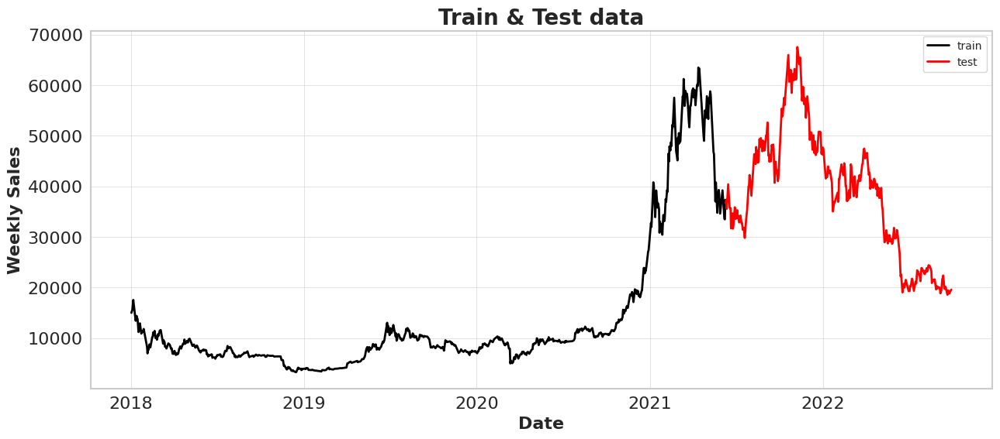

In [ ]:
fig, ax = plt.subplots(figsize=(15, 6))
sns.lineplot(x = close_stock['date_f'][:1255], y = close_stock['Close'][:1255], color = 'black')
sns.lineplot(x = close_stock['date_f'][1255:], y = close_stock['Close'][1255:], color = 'red')

# Formatting
ax.set_title('Train & Test data', fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Date', fontsize = 16, fontdict=dict(weight='bold'))
ax.set_ylabel('Weekly Sales', fontsize = 16, fontdict=dict(weight='bold'))
plt.tick_params(axis='y', which='major', labelsize=16)
plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(loc='upper right' ,labels = ('train', 'test'))

In [ ]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100 
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [ ]:
time_step = 15
X_train, y_train = create_dataset(train_data, time_step)
X_test, y_test = create_dataset(test_data, time_step)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test", y_test.shape)

X_train:  (1196, 15)
y_train:  (1196,)
X_test:  (504, 15)
y_test (504,)


In [ ]:
from xgboost import XGBRegressor
my_model = XGBRegressor(n_estimators=500,verbosity = 0)
my_model.fit(X_train, y_train, verbose=False)

XGBRegressor(n_estimators=500, verbosity=0)

In [ ]:
my_model

XGBRegressor(n_estimators=500, verbosity=0)

In [ ]:
import math 
predictions = my_model.predict(X_test)
print("Mean Absolute Error - MAE : " + str(mean_absolute_error(y_test, predictions)))
print("Root Mean squared Error - RMSE : " + str(math.sqrt(mean_squared_error(y_test, predictions))))

Mean Absolute Error - MAE : 0.041714418396830585
Root Mean squared Error - RMSE : 0.05634731709077659


In [ ]:
train_predict=my_model.predict(X_train)
test_predict=my_model.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (1196, 1)
Test data prediction: (504, 1)


In [ ]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1)) 
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1)) 

In [ ]:
import os
import pandas as pd
import numpy as np
import math
import datetime as dt

from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score 
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler

from itertools import cycle
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'date_f': close_stock['date_f'],
                       'original_close': close_stock['Close'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['date_f'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Close price','date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (1732, 1)
Test predicted data:  (1732, 1)


El modelo parece mucho más robusto que los anteriores. Presenta un MAE de  0.041714418396830585

#####**Validación Simple**:

Teniendo en cuenta el modelo de XGBOOST, haremos una validación simple como proceso de optimización. Para ello deberemos separar las variables en train y test.

In [ ]:
X = df_BTC[['date_f']]
y = df_BTC['Close']
X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.2, shuffle=True)
print(X_train.shape, X_test.shape)

(1971, 1) (493, 1)


In [ ]:
# Modelo
model =RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
# Ajuste
model.fit(X_train,y_train)

RandomForestRegressor(max_depth=4, n_estimators=10, random_state=42)

In [ ]:
predicciones= model.predict(X_test)

In [ ]:
# Validacion simple
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print('MAE: ',mean_absolute_error(y_true= y_test, y_pred= predicciones))

MAE:  2129.3097281418586


####**MODELO 3: XGBoost con todas las variables**

In [ ]:
import pandas as pd
import xgboost as xgb
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [ ]:
# Load the data
dataset = df_BTC.values
X, y = dataset[:,:3], dataset[:,3]
 
# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y,
                      test_size = 0.2, random_state = 123)

In [ ]:
#Creamos el objeteo XGBoost
regressor = xgb.XGBRegressor(
    n_estimators=80,
    reg_lambda=1, # L1 regularization term on weights
    gamma=0, # Minimum loss reduction required to make a further partition on a leaf node of the tree
    max_depth=3
)

In [ ]:
#Fiteamos
regressor.fit(X_train, y_train)

[22:32:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(n_estimators=80)

In [ ]:
X_train


array([[10242.330078125, 10503.912109375, 10238.1357421875],
       [38392.625, 40782.078125, 37905.8359375],
       [21160.392578125, 21668.845703125, 21103.197265625],
       ...,
       [13780.9951171875, 13862.033203125, 13628.3779296875],
       [3604.687255859375, 3612.67138671875, 3567.245849609375],
       [10518.1142578125, 10595.6376953125, 10409.0908203125]],
      dtype=object)

In [ ]:
y_train

array([10363.138671875, 39294.19921875, 21534.12109375, ..., 13737.109375,
       3583.9658203125, 10441.2763671875], dtype=object)

In [ ]:
#Predecimos
y_pred = regressor.predict(X_test)

In [ ]:
#Error
mean_absolute_error(y_test, y_pred)

308.5289268261521

#####**K FOLD - CV**:

Teniendo en cuenta el modelo de XGBOOST, haremos una validación cruzada como proceso de optimización. Para ello deberemos separar las variables en train y test.

In [ ]:
# k-fold cross validation evaluation of xgboost model
from numpy import loadtxt
import xgboost
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
# load data
dataset = df_BTC.values
dataset

array([[430.72100830078125, 436.2460021972656, 427.5150146484375, ...,
        434.3340148925781, 36278900, Timestamp('2016-01-01 00:00:00')],
       [434.62200927734375, 436.06201171875, 431.8699951171875, ...,
        433.43798828125, 30096600, Timestamp('2016-01-02 00:00:00')],
       [433.5780029296875, 433.7430114746094, 424.70599365234375, ...,
        430.010986328125, 39633800, Timestamp('2016-01-03 00:00:00')],
       ...,
       [19221.83984375, 20338.455078125, 18915.66796875, ...,
        19110.546875, 58571439619, Timestamp('2022-09-27 00:00:00')],
       [19104.62109375, 19688.34375, 18553.296875, ..., 19426.720703125,
        53071298734, Timestamp('2022-09-28 00:00:00')],
       [19427.779296875, 19589.265625, 18924.353515625, ...,
        19573.05078125, 41037843771, Timestamp('2022-09-29 00:00:00')]],
      dtype=object)

In [ ]:
df_BTC.head()

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2016-01-01,430.721008,436.246002,427.515015,434.334015,434.334015,36278900,2016-01-01
2016-01-02,434.622009,436.062012,431.869995,433.437988,433.437988,30096600,2016-01-02
2016-01-03,433.578003,433.743011,424.705994,430.010986,430.010986,39633800,2016-01-03
2016-01-04,430.061005,434.516998,429.084015,433.091003,433.091003,38477500,2016-01-04
2016-01-05,433.069000,434.182007,429.675995,431.959991,431.959991,34522600,2016-01-05


In [ ]:
# k-fold cross validation evaluation of xgboost model
from numpy import loadtxt
import xgboost
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
# load data
dataset = df_BTC.values
# split data into X and y
X, y = dataset[:,:3], dataset[:,3]
# CV model
model = XGBRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive


In [ ]:
scores = abs(scores)
print('Mean MAE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Mean MAE: 271.269 (25.880)


MAE es bastante alto

#####**Optimización- GridSearch**

In [ ]:
#Separamos los datos en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [ ]:
#Hypertuning utilizando grid search y vamos a usar un RandomForestRegressor como modelo
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor 
random_forest = RandomForestRegressor() #Instanciamos el modelo

In [ ]:
# Definimos los valores para los hiperparametros del RFR
params = {
    'n_estimators' : [50],

    'criterion': ['mse', 'absolute_error'],
    'max_depth':[4,5]
}

# Vamos a buscar en 8 configuraciones distintas de un RFR
grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  
                                  cv = 2, # Cross validation
                                  verbose = 3, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

In [ ]:
#Entrenamos el modelo
grid_random_forest.fit(X_train, y_train)

Fitting 2 folds for each of 4 candidates, totalling 8 fits


GridSearchCV(cv=2, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'criterion': ['mse', 'absolute_error'],
                         'max_depth': [4, 5], 'n_estimators': [50]},
             scoring='neg_mean_absolute_error', verbose=3)

In [ ]:
#Obtenemos el mejor modelo
grid_random_forest.best_estimator_

RandomForestRegressor(criterion='mse', max_depth=4, n_estimators=50)

In [ ]:
grid_random_forest.best_params_

{'criterion': 'mse', 'max_depth': 4, 'n_estimators': 50}

In [ ]:
y_test

array([43961.859375, 756.2269897460938, 9123.41015625, 64949.9609375,
       11523.5791015625, 22803.08203125, 18058.904296875,
       3882.590087890625, 20231.26171875, 11323.3974609375,
       11758.283203125, 458.55499267578125, 3236.76171875,
       6228.81005859375, 6281.2001953125, 48199.953125, 4826.47998046875,
       21190.31640625, 28840.953125, 410.4440002441406, 40538.01171875,
       37337.53515625, 1179.969970703125, 64469.52734375, 11961.26953125,
       666.5230102539062, 38053.50390625, 11474.900390625, 5402.697265625,
       1187.8699951171875, 4922.798828125, 9316.6298828125,
       4022.168212890625, 5036.68115234375, 2518.659912109375,
       2515.35009765625, 1537.6700439453125, 8222.078125, 46281.64453125,
       9663.181640625, 9252.27734375, 605.9840087890625,
       661.2849731445312, 2574.7900390625, 12573.8125, 10763.232421875,
       613.9829711914062, 11074.599609375, 7881.8466796875,
       8673.2158203125, 33472.6328125, 7269.6845703125, 38737.26953125,


In [ ]:
X_test

array([[44578.27734375, 44578.27734375, 43456.69140625],
       [748.7559814453125, 777.989990234375, 733.9290161132812],
       [9231.1396484375, 9274.962890625, 9036.623046875],
       ...,
       [2668.6298828125, 2862.419921875, 2657.7099609375],
       [46415.8984375, 46623.55859375, 42207.2890625],
       [744.6199951171875, 746.8319702148438, 733.489990234375]],
      dtype=object)

In [ ]:
import numpy as np
from sklearn.model_selection import LeaveOneOut
cv = LeaveOneOut()

In [ ]:
# evaluar el modelo (criterio de comparacion MAE)
!pip install -U scikit-learn
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from statistics import mean 
from math import *

MAE = make_scorer(mean_absolute_error)
scores = cross_val_score(random_forest, X, y, scoring=MAE, cv=cv,error_score='raise',verbose=1)
# convertir a postivos
scores = abs(scores)
std = sqrt(mean(scores))
# reportar el performance
print('MAE: %.3f (%.3f)' % (mean(scores), std))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MAE: 231.755 (15.224)


[Parallel(n_jobs=1)]: Done 2464 out of 2464 | elapsed: 31.2min finished


Intentaremos predecir con otros modelos

####**MODELO 4: Random WALK**

Ahora analizaremos la regresión con las nuevas variables:

In [ ]:
# Selección fechas train-test
# ==============================================================================
inicio_train = '2020-01-01'
fin_train = '2022-07-30'

print(f"Serie temporal completa : {df_BTC.index.min()} --- {df_BTC.index.max()}  (n={len(df_BTC)})")
print(f"Fechas train            : {df_BTC.loc[inicio_train:fin_train].index.min()} --- {df_BTC.loc[inicio_train:fin_train].index.max()}  (n={len(df_BTC.loc[inicio_train:fin_train])})")
print(f"Fechas test             : {df_BTC.loc[fin_train:].index.min()} --- {df_BTC.loc[fin_train:].index.max()}  (n={len(df_BTC.loc[fin_train:])})")

Serie temporal completa : 2016-01-01 00:00:00 --- 2022-09-29 00:00:00  (n=2464)
Fechas train            : 2020-01-01 00:00:00 --- 2022-07-30 00:00:00  (n=942)
Fechas test             : 2022-07-30 00:00:00 --- 2022-09-29 00:00:00  (n=62)


In [ ]:
# Simulación Random Walk
# ==============================================================================
df_rw = df_BTC[['Close']].copy()
df_rw['pred_close'] = df_rw['Close'].shift(1)

# Error de test
# ==============================================================================
y_true = df_rw.loc[fin_train:, 'Close']
y_pred = df_rw.loc[fin_train:, 'pred_close']
metrica = mean_absolute_error(y_true, y_pred)

print(f'Error de test: {metrica}')
display(df_rw.loc[fin_train:,].head(4))

Error de test: 415.25396925403226


,Close,pred_close
Date,,
2022-07-30,23656.207031,23804.632812
2022-07-31,23336.896484,23656.207031
2022-08-01,23314.199219,23336.896484
2022-08-02,22978.117188,23314.199219


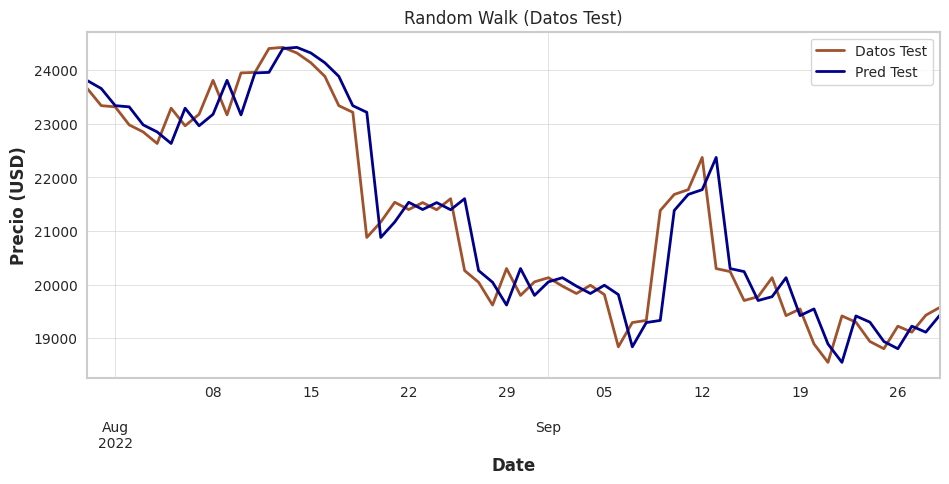

In [ ]:
# Gráfico
# ==============================================================================
fig, ax = plt.subplots(figsize=(11, 4.5))
df_rw.loc[fin_train:, 'Close'].plot(ax=ax, linewidth=2, label='Datos Test',
                                    c='sienna')
df_rw.loc[fin_train:, 'pred_close'].plot(ax=ax, linewidth=2, label='Pred Test',
                                    c='darkblue')
ax.set_title('Random Walk (Datos Test)')
ax.set_ylabel('Precio (USD)')
ax.legend();

In [ ]:
# DataFrame errores test modelos
# ==============================================================================
df_errores = pd.DataFrame({'modelo': 'Base - Random Walk', 'lags': 1, 
                           'error_test': metrica, 'variables_exog': False},
                          index=[0])
df_errores

,modelo,lags,error_test,variables_exog
0,Base - Random Walk,1,415.253969,False


El error del modelo en la partición de test es de 415.253969. Parece alto en relación a los otros modelos

##ETH

Ethereum es una plataforma de código abierto, que sirve para ejecutar contratos inteligentes.Es programable, lo que significa que los desarrolladores pueden usarlo en la creación de aplicaciones descentralizada (wikipedia).

Analizaremos su comportamiento:

#### Feature Engineering

In [ ]:
df_cr_reg_eth=df_cr_r.query("ticker=='ETH'")
df_cr_reg_eth.head(8000)

,date_f,volume,price_usd,market_cap,ticker,USD_price_change_1_day,price_dia_ant,variacion_precio
1746,2016-01-01,2.060620e+05,0.948024,7.198039e+07,ETH,0.000000,0.948024,0.000000
1747,2016-01-02,2.555040e+05,0.937124,7.117666e+07,ETH,-0.011498,0.947899,-0.011367
1748,2016-01-03,4.076320e+05,0.971905,7.384329e+07,ETH,0.037115,0.935833,0.038545
1749,2016-01-04,3.462450e+05,0.954480,7.254371e+07,ETH,-0.017929,0.971593,-0.017613
1750,2016-01-05,2.198330e+05,0.950176,7.224097e+07,ETH,-0.004509,0.954461,-0.004489
...,...,...,...,...,...,...,...,...
3487,2020-10-29,1.292048e+10,386.730000,4.378225e+10,ETH,-0.004940,388.640515,-0.004916
3488,2020-10-30,1.368806e+10,382.820000,4.334468e+10,ETH,-0.010110,386.690468,-0.010009
3489,2020-10-31,1.127696e+10,386.590000,4.377683e+10,ETH,0.009848,382.782873,0.009946
3490,2020-11-01,1.047515e+10,396.360000,4.488831e+10,ETH,0.025272,386.343090,0.025927


In [ ]:
df_cr_r_eth=df_cr_reg_eth[['date_f','volume','price_usd','market_cap','price_dia_ant','variacion_precio']]
df_cr_r_eth= df_cr_r_eth.set_index('date_f')
df_cr_r_eth.sort_index(inplace=True)
df_cr_r_eth.head()

,volume,price_usd,market_cap,price_dia_ant,variacion_precio
date_f,,,,,
2016-01-01,206062.0,0.948024,71980386.0,0.948024,0.000000
2016-01-02,255504.0,0.937124,71176658.0,0.947899,-0.011367
2016-01-03,407632.0,0.971905,73843292.0,0.935833,0.038545
2016-01-04,346245.0,0.954480,72543707.0,0.971593,-0.017613
2016-01-05,219833.0,0.950176,72240974.0,0.954461,-0.004489


In [ ]:
#Analizaremos el caso del market_cap. Importamos una clase para manejar las marcas de los ejes en formato de fechas
import numpy as np
import bokeh
from bokeh.io import output_notebook, show, reset_output 
from bokeh.palettes import Spectral6 
from bokeh.models import ColumnDataSource, FactorRange, CategoricalColorMapper 
from bokeh.plotting import figure 
from bokeh.models import HoverTool 

from bokeh.io import show, output_file
from bokeh.plotting import figure
from bokeh.models import DatetimeTickFormatter

# Convertimos las columna Data a marcas de tiempo
df_cr_reg_eth.date_f= pd.to_datetime(df_cr_reg_eth.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Volumen',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot.line(df_cr_reg_eth.date_f, df_cr_reg_eth['volume'], legend_label='Volume', line_width=2)


# Personalizamos el eje X
line_plot.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot.add_tools(HoverTool())
line_plot.legend.location = "top_left"
show(line_plot)

In [ ]:
#Analizaremos el caso del volume.Importamos una clase para manejar las marcas de los ejes en formato de fechas
import bokeh
from bokeh.io import output_notebook, show, reset_output 
from bokeh.palettes import Spectral6 
from bokeh.models import ColumnDataSource, FactorRange, CategoricalColorMapper 
from bokeh.plotting import figure 
from bokeh.models import HoverTool 
import numpy as np
from bokeh.io import show, output_file
from bokeh.plotting import figure
from bokeh.models import DatetimeTickFormatter

# Convertimos las columna Data a marcas de tiempo
df_cr_reg_eth.date_f= pd.to_datetime(df_cr_reg_eth.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='market_cap',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot.line(df_cr_reg_eth.date_f, df_cr_reg_eth['market_cap'], legend_label='market_cap', line_width=2)


# Personalizamos el eje X
line_plot.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot.add_tools(HoverTool())
line_plot.legend.location = "top_left"
show(line_plot)

Si bien las escalas son distintas, esta es una primera aproximación del comportamiento del ETH en los inversores. En en año 2018 el market cap tuvo un repunte importante, sin embargo el volumen operado aumentaba pero no al mismo ritmo. Esto pudo haber generado mayor valor de la inversión entre los tenedores de ese momento, que poco a poco fueron incrementándose, por lo cual podemos suponer que si el precio aumentó pero no al mismo ritmo que el volumen, el market cap tuvo un ritmo oscilante.

Será necesario, seguir investigando la relación del precio de la cripto con estas dos variables para determinar si son relevantes en la determinación de su precio. Podríamos suponer por ley de oferta y demanda que un mayor volumen operado (Demanda) implica un mayor precio, afectando a los niveles de market_Cap, pero sería una hipótesis preliminar, que nos determinaría si estas dos variables son relevantes o no en el establecimiento de los precios.

In [ ]:
yf.pdr_override() 
df_ETH = pdr.get_data_yahoo("ETH-USD", start="2016-01-01", end="2022-09-30")

[*********************100%***********************]  1 of 1 completed


In [ ]:
df_ETH.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2017-11-09,308.644989,329.451996,307.056000,320.884003,320.884003,893249984
2017-11-10,320.670990,324.717987,294.541992,299.252991,299.252991,885985984
2017-11-11,298.585999,319.453003,298.191986,314.681000,314.681000,842300992
2017-11-12,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936
2017-11-13,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984


In [ ]:
df_ETH.duplicated()

Date
2017-11-09    False
2017-11-10    False
2017-11-11    False
2017-11-12    False
2017-11-13    False
              ...  
2022-09-25    False
2022-09-26    False
2022-09-27    False
2022-09-28    False
2022-09-29    False
Length: 1786, dtype: bool

In [ ]:
df_ETH.duplicated().sum().sum()

0

In [ ]:
df_ETH.isnull()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2017-11-09,False,False,False,False,False,False
2017-11-10,False,False,False,False,False,False
2017-11-11,False,False,False,False,False,False
2017-11-12,False,False,False,False,False,False
2017-11-13,False,False,False,False,False,False
...,...,...,...,...,...,...
2022-09-25,False,False,False,False,False,False
2022-09-26,False,False,False,False,False,False
2022-09-27,False,False,False,False,False,False


In [ ]:
df_ETH.isnull().sum().sum()

0

In [ ]:
df_ETH.isnull().sum(axis=1)

Date
2017-11-09    0
2017-11-10    0
2017-11-11    0
2017-11-12    0
2017-11-13    0
             ..
2022-09-25    0
2022-09-26    0
2022-09-27    0
2022-09-28    0
2022-09-29    0
Length: 1786, dtype: int64

In [ ]:
df_ETH.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1786 entries, 2017-11-09 to 2022-09-29
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       1786 non-null   float64
 1   High       1786 non-null   float64
 2   Low        1786 non-null   float64
 3   Close      1786 non-null   float64
 4   Adj Close  1786 non-null   float64
 5   Volume     1786 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 97.7 KB


In [ ]:
df_ETH['date_f']=df_ETH.index

In [ ]:
df_ETH.head()

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2017-11-09,308.644989,329.451996,307.056000,320.884003,320.884003,893249984,2017-11-09
2017-11-10,320.670990,324.717987,294.541992,299.252991,299.252991,885985984,2017-11-10
2017-11-11,298.585999,319.453003,298.191986,314.681000,314.681000,842300992,2017-11-11
2017-11-12,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936,2017-11-12
2017-11-13,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984,2017-11-13


####Uniendo API y Data Set

In [ ]:
ETH=pd.merge(df_cr_reg_eth, df_ETH, how='inner', on='date_f')[['date_f','market_cap','price_dia_ant','variacion_precio','Open','High','Low','Close','Adj Close','Volume']]
ETH

,date_f,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
0,2017-11-09,3.068558e+10,308.618723,0.039730,308.644989,329.451996,307.056000,320.884003,320.884003,893249984
1,2017-11-10,2.862319e+10,319.421957,-0.063151,320.670990,324.717987,294.541992,299.252991,299.252991,885985984
2,2017-11-11,3.010529e+10,298.454395,0.054365,298.585999,319.453003,298.191986,314.681000,314.681000,842300992
3,2017-11-12,2.946354e+10,314.534351,-0.021061,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936
4,2017-11-13,3.031283e+10,307.657926,0.029455,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984
...,...,...,...,...,...,...,...,...,...,...
1063,2020-10-29,4.378225e+10,388.640515,-0.004916,388.651062,393.227692,381.288757,386.730103,386.730103,12920477749
1064,2020-10-30,4.334468e+10,386.690468,-0.010009,386.730255,391.464722,375.092407,382.819977,382.819977,13688056970
1065,2020-10-31,4.377683e+10,382.782873,0.009946,382.820038,393.010132,381.295258,386.590332,386.590332,11276963426
1066,2020-11-01,4.488831e+10,386.343090,0.025927,386.590332,397.116119,385.165527,396.358185,396.358185,10475146018


In [ ]:
ETH_I=ETH.set_index('date_f')
ETH_I

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
date_f,,,,,,,,,
2017-11-09,3.068558e+10,308.618723,0.039730,308.644989,329.451996,307.056000,320.884003,320.884003,893249984
2017-11-10,2.862319e+10,319.421957,-0.063151,320.670990,324.717987,294.541992,299.252991,299.252991,885985984
2017-11-11,3.010529e+10,298.454395,0.054365,298.585999,319.453003,298.191986,314.681000,314.681000,842300992
2017-11-12,2.946354e+10,314.534351,-0.021061,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936
2017-11-13,3.031283e+10,307.657926,0.029455,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984
...,...,...,...,...,...,...,...,...,...
2020-10-29,4.378225e+10,388.640515,-0.004916,388.651062,393.227692,381.288757,386.730103,386.730103,12920477749
2020-10-30,4.334468e+10,386.690468,-0.010009,386.730255,391.464722,375.092407,382.819977,382.819977,13688056970
2020-10-31,4.377683e+10,382.782873,0.009946,382.820038,393.010132,381.295258,386.590332,386.590332,11276963426


In [ ]:
ETH_I.describe()

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
count,1.068000e+03,1068.000000,1068.000000,1068.000000,1068.000000,1068.000000,1068.000000,1068.000000,1.068000e+03
mean,3.331840e+10,322.138762,0.004030,323.193410,334.097430,310.771225,323.152113,323.152113,7.058670e+09
std,2.235874e+10,231.679820,0.051727,232.992949,244.622868,218.998530,232.852627,232.852627,5.739017e+09
min,8.751210e+09,84.117414,-0.297487,84.279694,85.342743,82.829887,84.308296,84.308296,6.217330e+08
25%,1.829431e+10,170.189357,-0.020342,170.754616,175.063793,166.606400,170.800346,170.800346,2.168670e+09
50%,2.474152e+10,228.181951,0.000465,228.438065,232.783852,222.878845,228.536285,228.536285,5.956378e+09
75%,4.360740e+10,397.896542,0.025103,399.462433,413.922005,386.524139,398.874870,398.874870,1.005641e+10
max,1.354007e+11,1395.790445,0.359747,1397.479980,1432.880005,1290.599976,1396.420044,1396.420044,2.988005e+10


En primera instancia, podemos observar que los precios promedio de apertura, cierre, máximos, mínimos se mantienen en el umbral de 310 a 334 con desviaciones estándar que rondan los 230. Al ser menor la desviación que la media, podríamos establecer en principio que los datos no tienen tanta "dispersión" en torno a la media. 

Todo el análisis de estas variables nos permitirá establecer qué tan robustos pueden ser los datos con los que contemos para establecer predicciones futuras.

Por otro lado observamos que los máximos y mínimos se encuentran bastante alejadosde los límites superiores e inferiores, sobre todo los máximos, rondando en valores cercanos a 1.400 cuando los LS rondan valores de 390, lo cual nos haría pensar que en todo el período analizado, puede que no hayan existido grandes desviaciones, pero cuando las hubieron fueron más por encima de la media que por debajo

In [ ]:
# Convertimos las columna Data a marcas de tiempo
BTC.date_f= pd.to_datetime(ETH.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot_2 = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Precio',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot_2.line(ETH.date_f, ETH['Open'], legend_label='Open', line_width=2)
line_plot_2.line(ETH.date_f, ETH['High'], legend_label='High', line_width=2,color='red')
line_plot_2.line(ETH.date_f, ETH['Low'], legend_label='Low', line_width=2,color='green')
line_plot_2.line(ETH.date_f, ETH['Close'], legend_label='Close', line_width=2,color='orange')

# Personalizamos el eje X
line_plot_2.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot_2.add_tools(HoverTool())
line_plot_2.legend.location = "top_left"
show(line_plot_2)

Podemos observar que a simple vista, por más que las escalas sean diferentes, el precio pareciera tener una dirección más acorde al market_cap que al volumen.

Vamos a analizar con mayor profundidad el caso del precio de cierre y el precio del día anterior:

In [ ]:
# Convertimos las columna Data a marcas de tiempo
ETH.date_f= pd.to_datetime(ETH.date_f) 

# Creamos e asignamos la figura a la variable line_plot
line_plot_3 = figure(width=1000, height=500, title='Comportamiento temporal', 
                   x_axis_label='Fecha', y_axis_label='Precio',x_axis_type='datetime') # Definimos el tipo de variable para el eje x

# Añadimos las lineas para cada variable (columna)
line_plot_3.line(ETH.date_f, ETH['price_dia_ant'], legend_label='Precio dia ant', line_width=2)
line_plot_3.line(ETH.date_f, ETH['Close'], legend_label='Close', line_width=2,color='orange')

# Personalizamos el eje X
line_plot_3.xaxis.formatter=DatetimeTickFormatter(
        hours=["%d %B %Y"],
        days=["%d %B %Y"],
        months=["%d %B %Y"],
        years=["%d %B %Y"])
line_plot_3.add_tools(HoverTool())
line_plot_3.legend.location = "top_left"
show(line_plot_3)

En general, no vemos una variación importante de un día al otro. Lo confirmaremos con el gráfico de variación

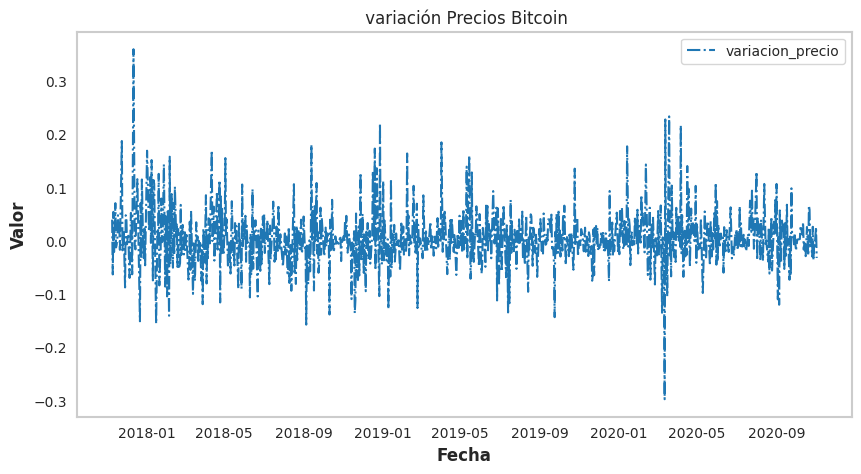

In [ ]:
ETH_I['Date']=ETH_I.index
ETH_I.head()


fig,ax= plt.subplots(figsize=(10,5))
ax.plot(ETH_I.Date, ETH_I.variacion_precio, label='variacion_precio',linewidth=1.5,linestyle='-.' )

ax.legend()
ax.grid()
ax.set_title(' variación Precios Bitcoin')
ax.set_xlabel('Fecha')
ax.set_ylabel('Valor')
plt.show()

En el gráfico de variación sí podemos observar algunas variaciones importantes de un día al otro en el año 2020 hacia mínimos, probablemente relacionado a los primeros meses de pandemia y luego máximos mostrando una recuperación y en 2018 mostrando el primer repunte en el valor de la cripto.

Analizaremos las correlaciones entre las distintas variables:

In [ ]:
ETH_I.corr()

,market_cap,price_dia_ant,variacion_precio,Open,High,Low,Close,Adj Close,Volume
market_cap,1.000000,0.992321,0.059526,0.992191,0.994745,0.995441,0.997712,0.997712,-0.195955
price_dia_ant,0.992321,1.000000,-0.023670,0.999908,0.997590,0.995222,0.994583,0.994583,-0.239889
variacion_precio,0.059526,-0.023670,1.000000,-0.022983,0.019127,0.025717,0.058690,0.058690,0.053039
Open,0.992191,0.999908,-0.022983,1.000000,0.997951,0.994619,0.994560,0.994560,-0.238742
High,0.994745,0.997590,0.019127,0.997951,1.000000,0.994927,0.997627,0.997627,-0.232842
Low,0.995441,0.995222,0.025717,0.994619,0.994927,1.000000,0.997061,0.997061,-0.245654
Close,0.997712,0.994583,0.058690,0.994560,0.997627,0.997061,1.000000,1.000000,-0.237580
Adj Close,0.997712,0.994583,0.058690,0.994560,0.997627,0.997061,1.000000,1.000000,-0.237580
Volume,-0.195955,-0.239889,0.053039,-0.238742,-0.232842,-0.245654,-0.237580,-0.237580,1.000000


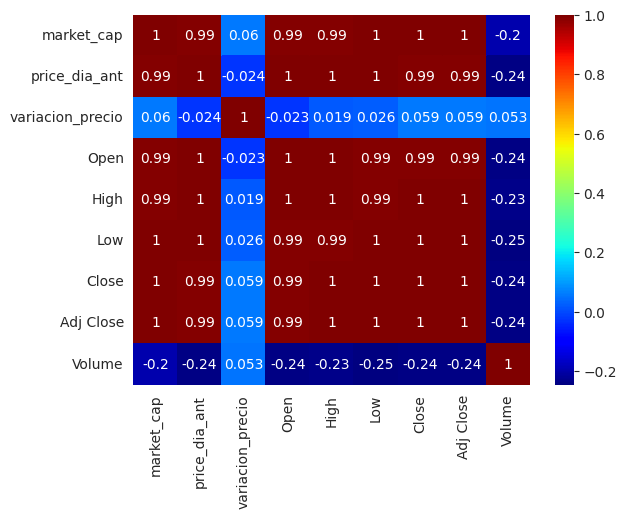

In [ ]:
sns.heatmap(ETH_I.corr(),annot=True,cmap='jet')
plt.show()

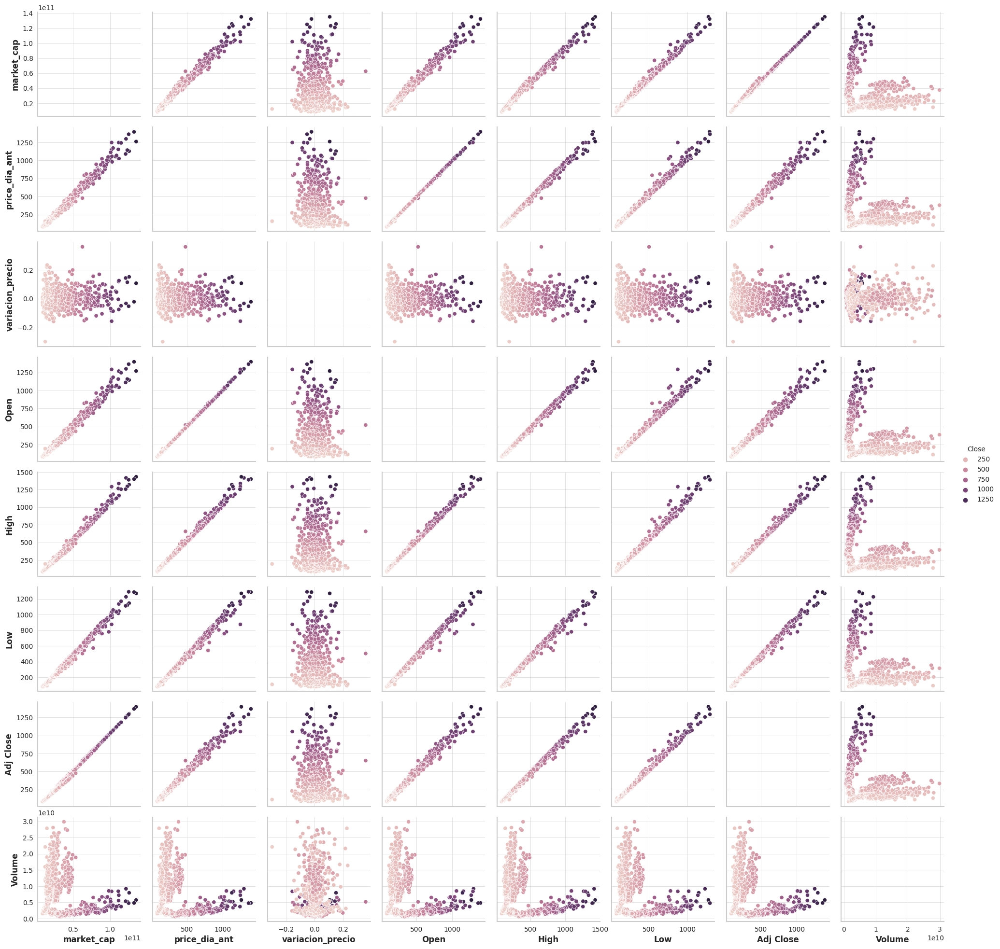

In [ ]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from seaborn.relational import lineplot 

sns.pairplot(ETH_I,hue='Close')

En general, podemos observar que la variable que menos se correlaciona con todas es la variación en el precio. Luego el volumen, por lo cual probablemente la cantidad operada de la moneda no tiene una relación tan significativa con los precios operados. 

Moving Average

Muestra el valor medio del precio de un instrumento durante un determinado período de tiempo. Cuando se calcula Moving Average, se promedia matemáticamente el precio del instrumento durante un período de tiempo dado. En función del cambio del precio, su valor medio va aumentando o disminuyendo. Es un indicador para el mercado de en qué momentos comprar o vender. El modo más común de interpretar la media móvil del precio consiste en la comparación de su dinámica con la dinámica del mismo precio. Cuando el precio del instrumento financiero sube por encima del valor de la Media Móvil, aparece la señal de compra, cuando baja de la línea del indicador – salta la señal de venta.

Intentaremos establecer que si se alternan los momentos de venta y compra en períodos más prolongados, probablemente sea una inversión de largo plazo.

Text(0.5, 1.0, 'ETH Close Price moving average')

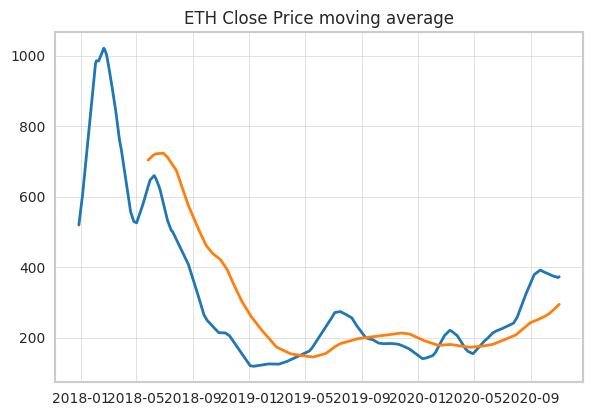

In [ ]:
fig = plt.figure(figsize = (15,10))

plt.subplot(2, 2, 1)
plt.plot(ETH['date_f'], ETH['Close'].rolling(50).mean())
plt.plot(ETH['date_f'], ETH['Close'].rolling(200).mean())
plt.title('ETH Close Price moving average')

Vemos cómo la media móvil oscila con el precio y corta a la línea del valor real en pocos momentos a lo largo de todos los años bajo estudio. Por lo tanto esta conclusión nos lleva a pensar que es una inversión de largo plazo.

Text(500, 40, 'ETH Close Price')

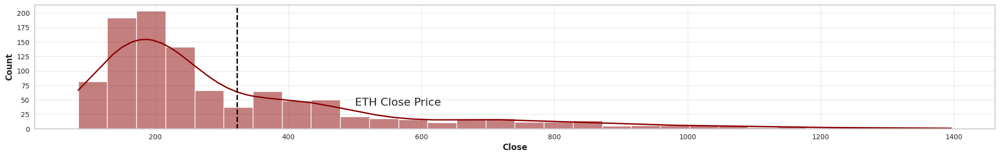

In [ ]:
fig = plt.figure(figsize = (25,15))

fig.tight_layout()

plt.subplot(4, 1, 1)
sns.histplot(ETH['Close'],color='darkred', kde=True)
plt.axvline(ETH['Close'].mean(), color='k', linestyle='dashed', linewidth=2)
plt.text(500,40,'ETH Close Price', fontsize=16)

Analizamos el precio de cierre y vemos que la mayoría de los valores en promedio se han ubicado el precios entre cero y 500

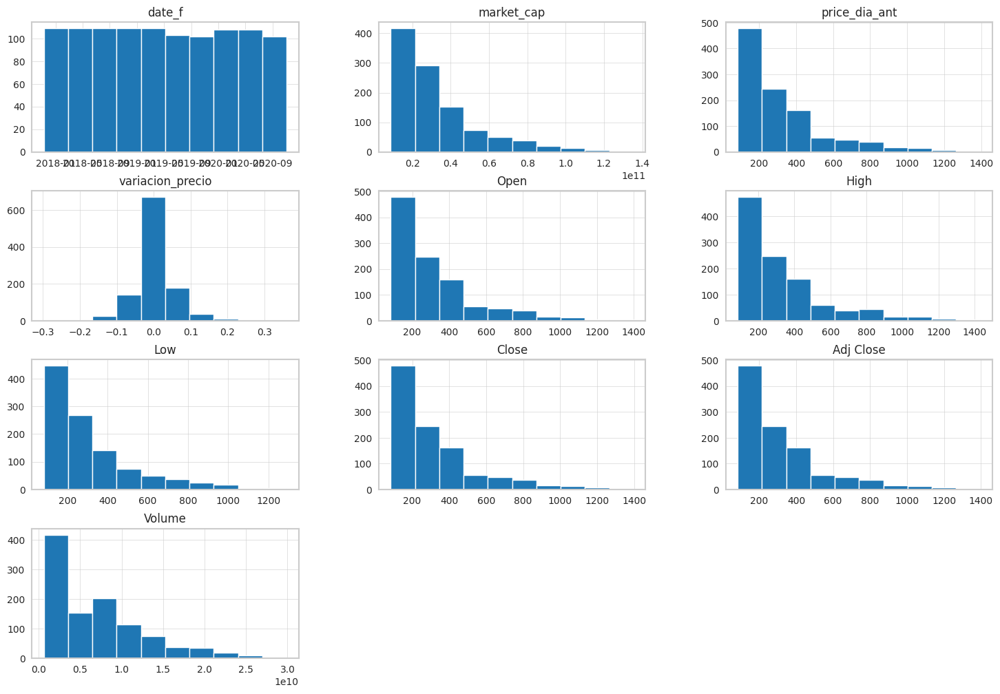

In [ ]:
ETH_numeric = ETH.select_dtypes(exclude = ["bool"])
ETH_numeric.hist(figsize=(18,12))
plt.show()

Los precios en el período analizado, presentan un comportamiento asimétrico, estando más sesgados a valores entre 0 y 500 USD. El caso de la variación en el precio presenta una distribución normal, y el volumen pareciera ser bastante asimétrico y con valores muy altos o muy bajos.

###¿Es el ETH una inversión de Corto o Largo Plazo?

A partir de lo observado podemos suponer que se trata de una inversión de Largo Plazo:

In [ ]:
ETH_I_close=ETH_I[['Close']]
ETH_I_close.head()

,Close
date_f,
2017-11-09,320.884003
2017-11-10,299.252991
2017-11-11,314.681000
2017-11-12,307.907990
2017-11-13,316.716003


In [ ]:
ETH_I_close['Date_2']=ETH_I_close.index
ETH_I_close

,Close,Date_2
date_f,,
2017-11-09,320.884003,2017-11-09
2017-11-10,299.252991,2017-11-10
2017-11-11,314.681000,2017-11-11
2017-11-12,307.907990,2017-11-12
2017-11-13,316.716003,2017-11-13
...,...,...
2020-10-29,386.730103,2020-10-29
2020-10-30,382.819977,2020-10-30
2020-10-31,386.590332,2020-10-31


In [ ]:
import plotly.graph_objects as go # importamos los objetos de plotly
import plotly.express as px

fig_ETH=px.line(data_frame=ETH_I_close, x='Date_2',y='Close',title='Precio ETH', 
                 labels={"Date_2":"Fecha", "Close":"Precio"})
fig_ETH.update_layout(paper_bgcolor="#FFFFFa",plot_bgcolor='#FFFFFa',)

fig_ETH.show()

Los mayores valores se observan en períodos largos de tiempo. Incluso sabiendo cómo se ha comportado BTC en períodos posteriores al analizado, hasta la fecha comprobamos que los valores máximos alcanzados fueron mayores al máximo que podemos observar en 2017 dado el dataset que nos limita obtener más información.


In [ ]:
df_ETH_close=df_ETH[['Close','date_f']]
df_ETH_close

,Close,date_f
Date,,
2017-11-09,320.884003,2017-11-09
2017-11-10,299.252991,2017-11-10
2017-11-11,314.681000,2017-11-11
2017-11-12,307.907990,2017-11-12
2017-11-13,316.716003,2017-11-13
...,...,...
2022-09-25,1294.216797,2022-09-25
2022-09-26,1335.320190,2022-09-26
2022-09-27,1330.127686,2022-09-27


In [ ]:
import plotly.graph_objects as go # importamos los objetos de plotly
import plotly.express as px

fig_ETH=px.line(data_frame=df_ETH_close, x='date_f',y='Close',title='Precio ETH', 
                 labels={"date_f":"Fecha", "Close":"Precio"})
fig_ETH.update_layout(paper_bgcolor="#FFFFFa",plot_bgcolor='#FFFFFa',)

fig_ETH.show()

Vemos como ampliando la serie, a través de los datos de la API, los valores máximos se dieron a finales de 2021.

In [ ]:
!pip install mplfinance
from pandas_datareader import data as pdr
from datetime import datetime, timedelta
import mplfinance as mpf

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
init_date=datetime.now()-timedelta(days=100)
print("FECHA DE INICIO: ", init_date)

FECHA DE INICIO:  2022-10-02 23:38:54.189891


In [ ]:
df_in_eth= pdr.get_data_yahoo("ETH-USD", start=init_date)
print(df_in_eth.head(10))

[*********************100%***********************]  1 of 1 completed
                   Open         High          Low        Close    Adj Close  \
Date                                                                          
2022-10-02  1311.753418  1316.330078  1275.336060  1276.093506  1276.093506   
2022-10-03  1276.163452  1326.554443  1271.150879  1323.439209  1323.439209   
2022-10-04  1323.278320  1364.970947  1320.076660  1362.126587  1362.126587   
2022-10-05  1361.972900  1362.451782  1320.855103  1352.837158  1352.837158   
2022-10-06  1352.806641  1380.404907  1349.449951  1351.709473  1351.709473   
2022-10-07  1351.836426  1359.328125  1321.746094  1332.516968  1332.516968   
2022-10-08  1332.371338  1335.954834  1307.072998  1315.500488  1315.500488   
2022-10-09  1315.460205  1327.668823  1309.344604  1322.604248  1322.604248   
2022-10-10  1322.618652  1335.662720  1291.337646  1291.337646  1291.337646   
2022-10-11  1291.109619  1296.273926  1272.737671  1279.575684

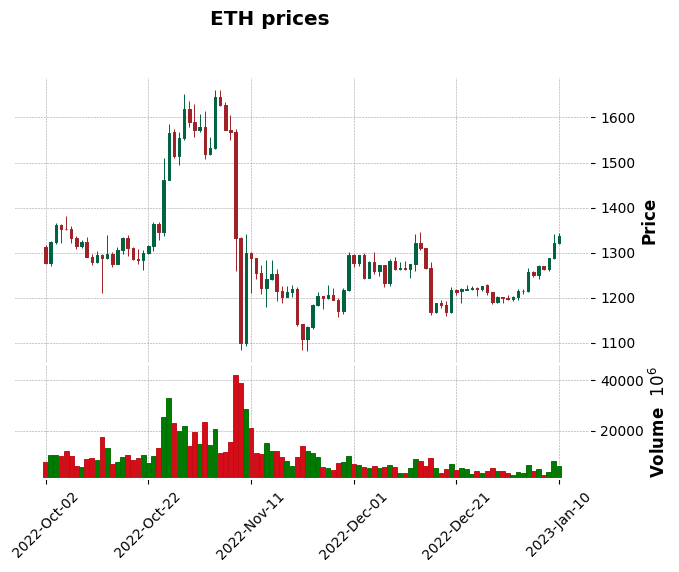

In [ ]:
mpf.plot(df_in_eth, type='candle', title='ETH prices',volume=True, style='charles')

En este caso, podemos observar como en el año 2022 los precios han disminuido notablemente. No sería conveniente dejar fuera del análisis estos valores que podrían aportar información significativa a los modelos. 

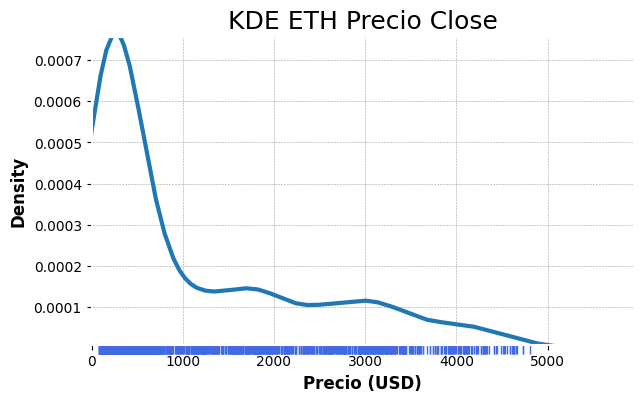

In [ ]:
fig, ax = plt.subplots(figsize=(7, 4))
p = sns.kdeplot(data=df_ETH_close, x='Close', linewidth=3, ax=ax)
r = sns.rugplot(data=df_ETH_close, x='Close', ax=ax, c='royalblue',
                height=-.03, clip_on=False)
p.set(xlim=(0, None))
p.set_title('KDE ETH Precio Close', fontsize=18)
p.set_xlabel('Precio (USD)');

En los datos de estudio se observa una distribución mayoritaria de precios por debajo de los 1000 (USD). Esta etapa corresponde al periodo entre el año 2018 y septiembre de 2021. En cambio, desde 2021, el precio se ha situado en la zona de los 1000 - 5000 (USD).

Tratar de modelar una serie temporal con una distribución muy asimétrica y distintos órdenes de magnitud a lo largo del tiempo puede ser complicado. 

In [ ]:
# Analizaremos las variaciones por año. Se localizan los datos correspondientes para cada año para el caso de los datos de la API
# ==============================================================================
years = list(df_ETH.index.year.unique())
df_plot = pd.DataFrame()

for year in years:
    
    year_open  = df_ETH.loc[df_ETH.index.year == year, 'Open'][0]
    year_close = df_ETH.loc[df_ETH.index.year == year, 'Close'][-1]
    year_low   = df_ETH.loc[df_ETH.index.year == year, 'Low'].min()
    year_high  = df_ETH.loc[df_ETH.index.year == year, 'High'].max()
    
    df_plot[year] = pd.Series([year_open, year_close, year_low, year_high]) 
    
df_plot = df_plot.T
df_plot = df_plot.set_axis(['Open', 'Close', 'Low', 'High'], axis=1)

# Se calcula el % de cambio entre el open y el close del año
# ==============================================================================
df_plot['year_change'] = 100*(df_plot['Close'] - df_plot['Open']) / df_plot['Open']
df_plot.head(7)

,Open,Close,Low,High,year_change
2017,308.644989,756.732971,294.541992,881.943970,145.179089
2018,755.757019,133.368256,82.829887,1432.880005,-82.353025
2019,133.418152,129.610855,102.934563,361.398682,-2.853657
2020,129.630661,737.803406,95.184303,754.303223,469.158099
2021,737.708374,3682.632812,718.109497,4891.704590,399.198998
2022,3683.047119,1335.652344,896.109009,3876.785156,-63.735127


In [ ]:
# Se crea una lista de dicts con las anotaciones de % de cambio para el gráfico
# ==============================================================================
annotations_list = []
max_high = df_plot['High'].max()

for year in years:
    
    df_aux = df_plot.loc[df_plot.index == year,]
    loc_x  = pd.to_datetime(df_aux.index[0], format='%Y')
    loc_y  = df_aux['High'].values[0]/max_high + 0.05
    text   = '{:.1f}%'.format(df_aux['year_change'].values[0])
    
    annotation = dict(x=loc_x, y=loc_y, 
                      xref='x', yref='paper',
                      showarrow=False, xanchor='center', 
                      text=text)

    annotations_list.append(annotation)

# Gráfico de velas japonesas anual interactivo con Plotly
# ==============================================================================
fig = go.Figure(data=[go.Candlestick(x= pd.to_datetime(df_plot.index, format='%Y'),
                  open  = df_plot.Open,
                  close = df_plot.Close,
                  low   = df_plot.Low,
                  high  = df_plot.High)])



fig.update_layout(
    width       = 800,
    height      = 350,
    title       = dict(text='<b>Chart Bitcoin/USD por año</b>', font=dict(size=25)),
    yaxis_title = dict(text='Precio (USD)', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    xaxis_rangeslider_visible = False,
    annotations = annotations_list
)

fig.show()

Todas las variaciones en el precio, nos lleva a determinar que es una inversión de largo plazo, en la cual el inversor debe ser paciente para obtener beneficios. Teniendo en cuenta esto, es importante no dejar afuera ningún dato para la construcción de modelos de ML.

**Feature Selection**

Con los datos analizados en EDA, llegamos a la conclusión que será más importante para el análisis considerar datos de un mayor período de tiempo. Para ello deberemos quedarnos con los datos proporcionados por la API, teniendo en cuenta que la mayoría de las variables que quedan fuera del análisis no tienen una fuerte correlación con el precio, por lo cual descartarlas en principio no afectaría el análisis. 

Analizaremos la media móvil y la variación del precio para el período considerado en la API.

Text(0.5, 1.0, 'ETH Close Price moving average')

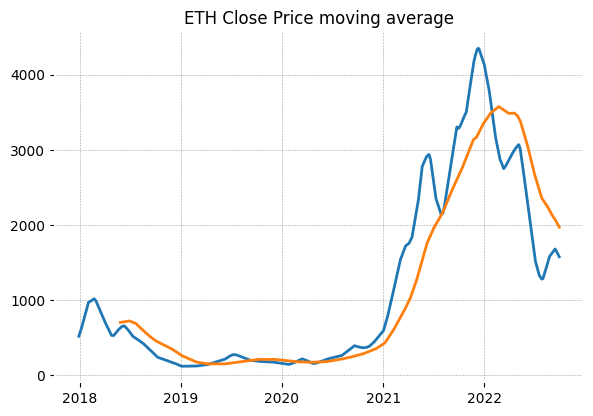

In [ ]:
fig = plt.figure(figsize = (15,10))

plt.subplot(2, 2, 1)
plt.plot(df_ETH['date_f'], df_ETH['Close'].rolling(50).mean())
plt.plot(df_ETH['date_f'], df_ETH['Close'].rolling(200).mean())
plt.title('ETH Close Price moving average')

Vemos cómo la media móvil oscila en mayor medida al considerar las variables de la API, y un mayor período de tiempo.

Text(5000, 40, 'Bitcoin Close Price')

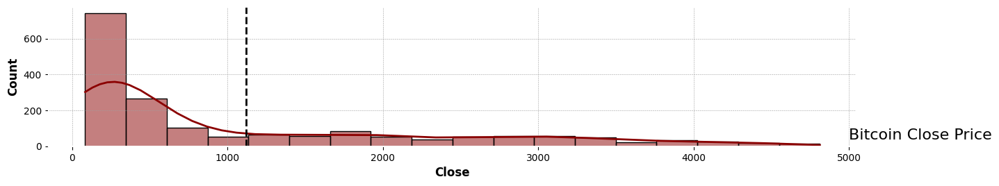

In [ ]:
fig = plt.figure(figsize = (15,12))

fig.tight_layout()

plt.subplot(4, 1, 1)
sns.histplot(df_ETH['Close'],color='darkred', kde=True)
plt.axvline(df_ETH['Close'].mean(), color='k', linestyle='dashed', linewidth=2)
plt.text(5000,40,'Bitcoin Close Price', fontsize=16)

Analizamos el precio de cierre y vemos que la mayoría de los valores en promedio se han ubicado el precios entre cero y 1000, lo cual amplía los resultados.

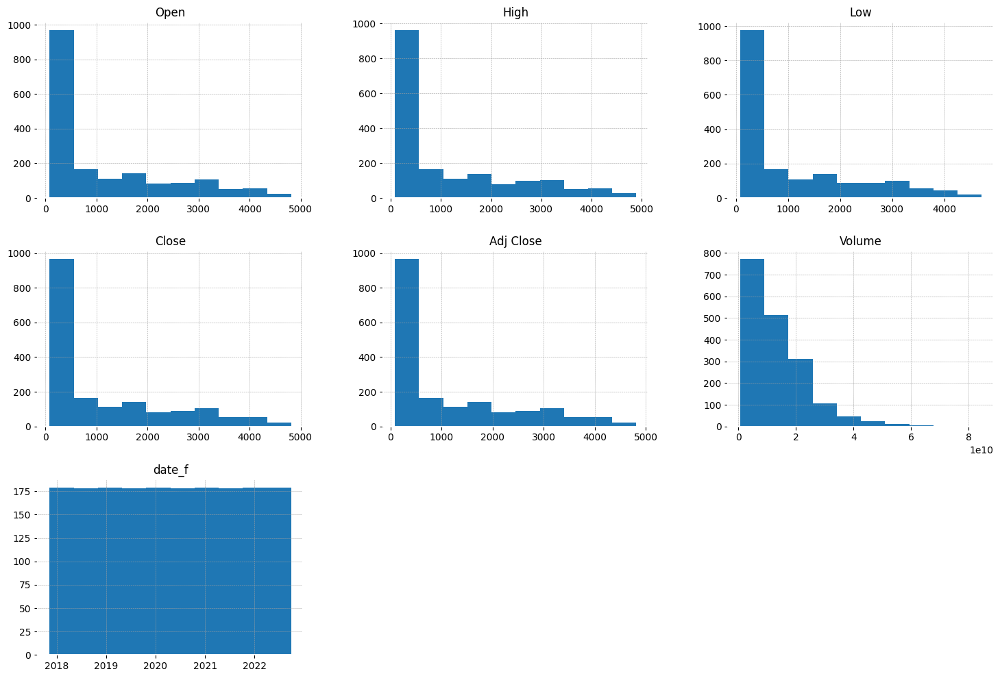

In [ ]:
bit_numeric = df_ETH.select_dtypes(exclude = ["bool"])
bit_numeric.hist(figsize=(18,12))
plt.show()

###¿Podremos predecir el valor futuro?

Intentaremos hacer una aproximación a través del modelo ARIMA para series de tiempo:

####**MODELO 1: REGRESIÓN**: 

Utilizaremos los valores de la API, según las conclusiones a las que pudimos llegar en los pasos anteriores.

In [ ]:
#comenzamos estableciendo los valores con una regresión simplre
import pandas as pd
from scipy import stats
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf
from bokeh.resources import INLINE
import bokeh.io
from bokeh import *
bokeh.io.output_notebook(INLINE)
# var dep ~ vars indepen, + añade nuevas columnas
model1 = 'Close~Open+High+Low+Volume' 
# crea un modelo/regresión para las variables y se ajusta con .fit()
lm1 = smf.ols(formula = model1, data = df_ETH).fit()
# se presenta un resumen de los residuos del modelo
print(lm1.summary()) 
# OLS es ordinary least squares

                            OLS Regression Results                            
Dep. Variable:                  Close   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 5.621e+05
Date:                Tue, 10 Jan 2023   Prob (F-statistic):               0.00
Time:                        23:51:00   Log-Likelihood:                -8845.0
No. Observations:                1786   AIC:                         1.770e+04
Df Residuals:                    1781   BIC:                         1.773e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.4819      1.336     -0.361      0.7

Variable dependiente es 'price_usd', usamos OLS conocidos como mínimos cuadrados ordinarios.

El número de observaciones es significativo. Df Residuals es otro nombre para nuestros Grados de Libertad en nuestro modo.

Df model es el número de nuestras variables de predicción (Open, High, Low, Volume).

Nuestro tipo de covarianza aparece como no robusto. Una covarianza robusta es aquella que se calcula de manera que se minimicen o eliminen las variables, lo que no es el caso aquí.

R-squared es la medida de cuánto de la variable dependiente se explica por cambios en nuestras variables independientes. En términos porcentuales, 0,999 significaría que nuestro modelo explica el 99.9% del cambio en nuestra variable 'Close'.

El Adj R-squared penaliza la fórmula R-squared en función del número de variables, por lo tanto, una puntuación ajustada más baja puede indicarle que algunas variables no están contribuyendo correctamente al R-squared de su modelo.En nuestro caso esto no sucede ya que el valor es igual al 99,9%

Según este modelo, el precio de cierre del bitcoin tiene una relación positiva con el precio Low, High y Volume pero negativa con Open.

A partir de nuestra fórmula Close~Open+High+Low+Volume , se muestra las variables independientes, en nuestro caso son: Open+High+Low+Volume 

El std err es una estimación de la desviación estándar del coeficiente, una medida de la cantidad de variación en el coeficiente a lo largo de sus puntos de datos.

La t está relacionada y es una medida de la precisión con la que se midió el coeficiente, estás se calculan asumiendo la siguiente hipótesis

H0 : La variable X no influye en Y HA : X tiene un impacto significativo en Y

En teoría, leemos que el valores-p es la probabilidad de obtener el estadístico t para rechazar con H0 En la tabla de resumen, podemos ver que el valor-p para ambos parámetros es igual a 0. Esto no es exactamente 0, pero como tenemos estadísticos t muy grandes el valor p será aproximadamente 0.

Otra forma de probar la hipotesis, es incluir el enfoque de intervalos de confianza, esto nos dice que la estimación del parámetro corresponiente tiene el 95% de estar entre las cotas marcadas.

Volume tiene un pvalue no significativo, podríamos excluirla del modelo.

**Control de Underflight u Overflights**

Es probable que nuestri modelo al tener un valor R cuadrado del 98% esté sobreajustado, por eso deberemos realizar el test para poder comprobarlo:

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets 
from sklearn.model_selection import train_test_split # para dividir el dataset
from sklearn.linear_model import LinearRegression # para hacer una regresión lineal
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error # metricas
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

df_ETH_x = df_ETH[['Open','High','Low','Adj Close']]
df_ETH_y = df_ETH['Close']

sns.set_style('whitegrid')
# dividimos el dataset
X_train,X_test,y_train,y_test = train_test_split(df_ETH_x,df_ETH_y,test_size=0.2,random_state=2) 

# instanciamos el modelo
lr = LinearRegression()

# Ajustar el modelo con X_train y y_train
lr.fit(X_train,y_train)

# hacemos una predeción con datos nuevos de X_test
y_pred = lr.predict(X_test)

In [ ]:
# Calculamos el MAE
print("MAE",mean_absolute_error(y_test,y_pred))

MAE 2.936248389060034e-13


In [ ]:
print("MSE",mean_squared_error(y_test,y_pred))

MSE 1.8161083484473855e-25


Este valor es bastante alejado de cero, por lo cual sería necesario seguir evaluando el modelo

In [ ]:
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))

RMSE 4.2615822747512287e-13


Será necesario establecer otro modelo para luego comparar los RMSE y determinar si alguno resulta más robusto que otro (y no sólo quedarnos con la conclusión del valor del MSE) 

In [ ]:
print("r2", r2_score(y_test,y_pred))

r2 1.0


Este valor que habíamos obtenido, nos indica que el modelo es robusto, pero es necesario hacer más pruebas para comprobar si esto es cierto

In [ ]:
y_pred=lr.predict(X_test)

In [ ]:
#Preparación de datos MOD 1
X = df_ETH[['Open','High','Low','Adj Close']]
y = df_ETH['Close']

In [ ]:
#Separacion en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
#Entrenamiento del modelo
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [ ]:
regressor.coef_

array([ 2.50951765e-16, -6.66133815e-16, -4.16333634e-16,  1.00000000e+00])

In [ ]:
regressor.intercept_

2.2737367544323206e-13

In [ ]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Open,2.509518e-16
High,-6.661338e-16
Low,-4.163336e-16
Adj Close,1.000000e+00


In [ ]:
#Realizando las predicciones
y_pred = regressor.predict(X_test)

In [ ]:
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df

,Actual,Predicted
Date,,
2019-05-01,160.818344,160.818344
2020-12-29,731.520142,731.520142
2021-07-21,1990.970825,1990.970825
2018-08-25,279.645996,279.645996
2022-09-08,1635.347656,1635.347656
...,...,...
2020-02-07,222.726059,222.726059
2019-04-27,158.434937,158.434937
2018-11-26,108.334999,108.334999


In [ ]:
#Evaluación de Modelos
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 1.3801994928703175e-13
Mean Squared Error: 4.398244177460707e-26
Root Mean Squared Error: 2.09719912680239e-13


In [ ]:
def mape(actual, predicted):
    return np.mean(np.abs((actual - predicted) / actual)) * 100
mape(y_test, y_pred)

5.368819550652526e-14

In [ ]:
from sklearn.metrics import r2_score
r2_score(y_test,y_pred)

1.0

#####**K FOLD - CV**:

Teniendo en cuenta el modelo de Regresión, haremos una validación cruzada como proceso de optimización. Para ello deberemos separar las variables en train y test.

In [ ]:
df_ETH

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2017-11-09,308.644989,329.451996,307.056000,320.884003,320.884003,893249984,2017-11-09
2017-11-10,320.670990,324.717987,294.541992,299.252991,299.252991,885985984,2017-11-10
2017-11-11,298.585999,319.453003,298.191986,314.681000,314.681000,842300992,2017-11-11
2017-11-12,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936,2017-11-12
2017-11-13,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984,2017-11-13
...,...,...,...,...,...,...,...
2022-09-25,1317.938477,1333.371338,1275.627686,1294.216797,1294.216797,11802651633,2022-09-25
2022-09-26,1294.386108,1335.526367,1282.049316,1335.320190,1335.320190,16034549271,2022-09-26
2022-09-27,1335.337036,1396.891479,1308.991455,1330.127686,1330.127686,17870598937,2022-09-27


In [ ]:
X = df_ETH[['Open','High','Low','Adj Close']]
y = df_ETH['Close']

In [ ]:
#Separacion en train y test
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

In [ ]:
sns.set_style('whitegrid')
# dividimos el dataset
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=2) 

# instanciamos el modelo
lr = RandomForestRegressor()

# Ajustar el modelo con X_train y y_train
lr.fit(X_train,y_train)

# hacemos una predeción con datos nuevos de X_test
y_pred = lr.predict(X_test)

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error

# crear el modelo
model = RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
scores = cross_val_score(model, X, y, cv=7, verbose=1,scoring='neg_mean_absolute_error')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.2s finished


In [ ]:

print(X.shape, y.shape)

(1786, 4) (1786,)


In [ ]:
model = RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
scores = cross_val_score(model, X,y, cv=7, verbose=1,scoring='neg_mean_absolute_error')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.2s finished


In [ ]:
print("%0.2f de mae promedio con una desviacion estandar de %0.2f" % (-scores.mean(), scores.std()))

83.80 de mae promedio con una desviacion estandar de 104.90


#####**Optimización- GridSearch**

In [ ]:
#Separamos los datos en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [ ]:
#Hypertuning utilizando grid search y vamos a usar un RandomForestRegressor como modelo
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor 
random_forest = RandomForestRegressor() #Instanciamos el modelo

In [ ]:
# Definimos los valores para los hiperparametros del RFR
params = {
    'n_estimators' : [50],
    'max_features': [4,5],
    'criterion': ['mse', 'absolute_error'],
    'max_depth':[4,5]
}

# Vamos a buscar en 8 configuraciones distintas de un RFR
grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  
                                  cv = 2, # Cross validation
                                  verbose = 3, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

In [ ]:
#Entrenamos el modelo
grid_random_forest.fit(X_train, y_train)

Fitting 2 folds for each of 8 candidates, totalling 16 fits


GridSearchCV(cv=2, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'criterion': ['mse', 'absolute_error'],
                         'max_depth': [4, 5], 'max_features': [4, 5],
                         'n_estimators': [50]},
             scoring='neg_mean_absolute_error', verbose=3)

In [ ]:
#Obtenemos el mejor modelo
grid_random_forest.best_estimator_

RandomForestRegressor(criterion='mse', max_depth=4, max_features=4,
                      n_estimators=50)

In [ ]:
grid_random_forest.best_params_

{'criterion': 'mse', 'max_depth': 4, 'max_features': 4, 'n_estimators': 50}

In [ ]:
y_test

Date
2021-06-28    2079.657471
2020-11-05     414.067352
2022-08-24    1657.059204
2020-04-20     172.297165
2019-06-01     265.391266
                 ...     
2018-05-19     696.530029
2020-03-19     136.593857
2021-08-04    2724.619873
2019-06-11     245.781830
2022-01-23    2535.039062
Name: Close, Length: 536, dtype: float64

In [ ]:
X_test

,Open,High,Low,Adj Close
Date,,,,
2021-06-28,1981.386475,2139.805420,1963.615479,2079.657471
2020-11-05,402.142944,417.525940,397.245819,414.067352
2022-08-24,1662.695435,1686.557739,1610.099243,1657.059204
2020-04-20,181.480225,186.083542,170.321274,172.297165
2019-06-01,268.433350,273.557983,263.524597,265.391266
...,...,...,...,...
2018-05-19,695.072021,715.578003,686.791016,696.530029
2020-03-19,114.839828,140.527725,114.732864,136.593857
2021-08-04,2508.544922,2764.443604,2463.469482,2724.619873


In [ ]:
import numpy as np
from sklearn.model_selection import LeaveOneOut
cv = LeaveOneOut()

In [ ]:
# evaluar el modelo (criterio de comparacion MAE)
!pip install -U scikit-learn
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from statistics import mean 
from math import *

MAE = make_scorer(mean_absolute_error)
scores = cross_val_score(random_forest, X, y, scoring=MAE, cv=cv,error_score='raise',verbose=1)
# convertir a postivos
scores = abs(scores)
std = sqrt(mean(scores))
# reportar el performance
print('MAE: %.3f (%.3f)' % (mean(scores), std))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MAE: 1.965 (1.402)


[Parallel(n_jobs=1)]: Done 1786 out of 1786 | elapsed: 18.1min finished


Intentaremos predecir con otros modelos

####**MODELO 2: XGBoost para Close con fecha**

In [ ]:
closedf = df_ETH[['date_f','Close']]
print("Shape of close dataframe:", closedf.shape)

Shape of close dataframe: (1786, 2)


In [ ]:
closedf = closedf[closedf['date_f'] > '2018-01-01']
close_stock = closedf.copy()
print("Total data for prediction: ",closedf.shape[0])

Total data for prediction:  1732


In [ ]:
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import multiprocessing
from sklearn.preprocessing import MinMaxScaler
# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#NORMALIZANDO

del closedf['date_f']
scaler=MinMaxScaler(feature_range=(0,1))
closedf=scaler.fit_transform(np.array(closedf).reshape(-1,1))
print(closedf.shape)

(1732, 1)


In [ ]:
training_size=int(len(closedf)*0.70)
test_size=len(closedf)-training_size
train_data,test_data=closedf[0:training_size,:],closedf[training_size:len(closedf),:1]
print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (1212, 1)
test_data:  (520, 1)


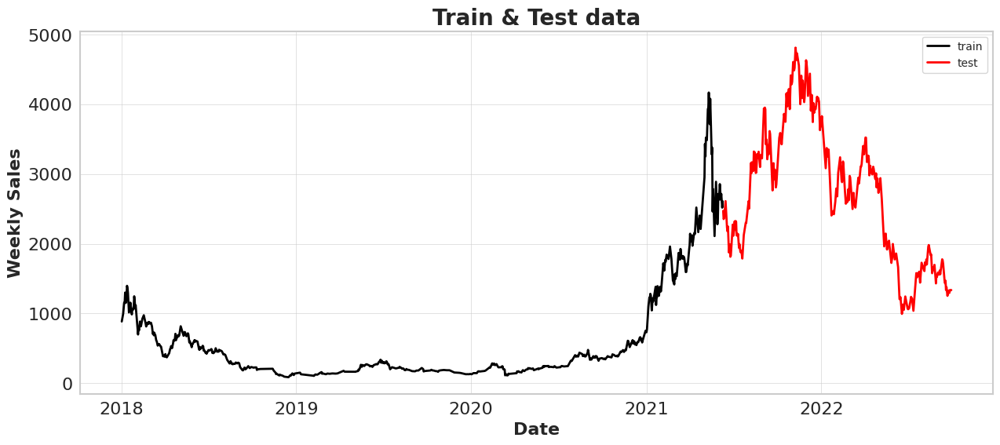

In [ ]:
fig, ax = plt.subplots(figsize=(15, 6))
sns.lineplot(x = close_stock['date_f'][:1255], y = close_stock['Close'][:1255], color = 'black')
sns.lineplot(x = close_stock['date_f'][1255:], y = close_stock['Close'][1255:], color = 'red')

# Formatting
ax.set_title('Train & Test data', fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Date', fontsize = 16, fontdict=dict(weight='bold'))
ax.set_ylabel('Weekly Sales', fontsize = 16, fontdict=dict(weight='bold'))
plt.tick_params(axis='y', which='major', labelsize=16)
plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(loc='upper right' ,labels = ('train', 'test'))

In [ ]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100 
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [ ]:
time_step = 15
X_train, y_train = create_dataset(train_data, time_step)
X_test, y_test = create_dataset(test_data, time_step)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test", y_test.shape)

X_train:  (1196, 15)
y_train:  (1196,)
X_test:  (504, 15)
y_test (504,)


In [ ]:
from xgboost import XGBRegressor
my_model = XGBRegressor(n_estimators=500,verbosity = 0)
my_model.fit(X_train, y_train, verbose=False)

XGBRegressor(n_estimators=500, verbosity=0)

In [ ]:
import math 
predictions = my_model.predict(X_test)
print("Mean Absolute Error - MAE : " + str(mean_absolute_error(y_test, predictions)))
print("Root Mean squared Error - RMSE : " + str(math.sqrt(mean_squared_error(y_test, predictions))))

Mean Absolute Error - MAE : 0.14252450530572147
Root Mean squared Error - RMSE : 0.1974280194100431


In [ ]:
my_model

XGBRegressor(n_estimators=500, verbosity=0)

In [ ]:
train_predict=my_model.predict(X_train)
test_predict=my_model.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (1196, 1)
Test data prediction: (504, 1)


In [ ]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1)) 
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1)) 

In [ ]:
import os
import pandas as pd
import numpy as np
import math
import datetime as dt

from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score 
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler

from itertools import cycle
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'date_f': close_stock['date_f'],
                       'original_close': close_stock['Close'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['date_f'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Close price','date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (1732, 1)
Test predicted data:  (1732, 1)


#####**Validación Simple**:

In [ ]:
X = df_ETH[['date_f']]
y = df_ETH['Close']
X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.2, shuffle=True)
print(X_train.shape, X_test.shape)

(1428, 1) (358, 1)


In [ ]:
# Modelo
model =RandomForestRegressor(random_state=42, n_estimators=10,max_depth=4)
# Ajuste
model.fit(X_train,y_train)

RandomForestRegressor(max_depth=4, n_estimators=10, random_state=42)

In [ ]:
predicciones= model.predict(X_test)

In [ ]:
# Validacion simple
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print('MAE: ',mean_absolute_error(y_true= y_test, y_pred= predicciones))

MAE:  131.8553684918766


####**MODELO 3: XGBoost con todas las variables**

In [ ]:
import pandas as pd
import xgboost as xgb
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [ ]:
# Load the data
dataset = df_ETH.values
X, y = dataset[:,:3], dataset[:,3]
 
# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y,
                      test_size = 0.2, random_state = 123)

In [ ]:
#Creamos el objeteo XGBoost
regressor = xgb.XGBRegressor(
    n_estimators=80,
    reg_lambda=1, # L1 regularization term on weights
    gamma=0, # Minimum loss reduction required to make a further partition on a leaf node of the tree
    max_depth=3
)

In [ ]:
#Fiteamos
regressor.fit(X_train, y_train)

[00:14:06] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(n_estimators=80)

In [ ]:
X_train

array([[225.43499755859375, 226.3699951171875, 222.99600219726562],
       [3008.9462890625, 3026.4150390625, 2786.253173828125],
       [223.3849334716797, 236.54713439941406, 218.61761474609375],
       ...,
       [3431.21728515625, 3615.28271484375, 3365.9130859375],
       [3246.77099609375, 3283.235595703125, 3158.84033203125],
       [3002.956787109375, 3029.0810546875, 2496.81298828125]],
      dtype=object)

In [ ]:
y_train

array([226.11900329589844, 2808.29833984375, 235.8511962890625, ...,
       3615.28271484375, 3227.002685546875, 2557.931640625], dtype=object)

In [ ]:
#Predecimos
y_pred = regressor.predict(X_test)

In [ ]:
#Error
mean_absolute_error(y_test, y_pred)

29.60505056114836

#####**K FOLD - CV**:

In [ ]:
# k-fold cross validation evaluation of xgboost model
from numpy import loadtxt
import xgboost
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
# load data
dataset = df_ETH.values
dataset

array([[308.6449890136719, 329.4519958496094, 307.0559997558594, ...,
        320.8840026855469, 893249984, Timestamp('2017-11-09 00:00:00')],
       [320.6709899902344, 324.7179870605469, 294.5419921875, ...,
        299.25299072265625, 885985984, Timestamp('2017-11-10 00:00:00')],
       [298.58599853515625, 319.4530029296875, 298.1919860839844, ...,
        314.6809997558594, 842300992, Timestamp('2017-11-11 00:00:00')],
       ...,
       [1335.3370361328125, 1396.8914794921875, 1308.991455078125, ...,
        1330.127685546875, 17870598937, Timestamp('2022-09-27 00:00:00')],
       [1329.5413818359375, 1351.9644775390625, 1267.8692626953125, ...,
        1337.410888671875, 18994979566, Timestamp('2022-09-28 00:00:00')],
       [1337.554443359375, 1348.107666015625, 1293.193359375, ...,
        1335.65234375, 13796915736, Timestamp('2022-09-29 00:00:00')]],
      dtype=object)

In [ ]:
df_ETH.head()

,Open,High,Low,Close,Adj Close,Volume,date_f
Date,,,,,,,
2017-11-09,308.644989,329.451996,307.056000,320.884003,320.884003,893249984,2017-11-09
2017-11-10,320.670990,324.717987,294.541992,299.252991,299.252991,885985984,2017-11-10
2017-11-11,298.585999,319.453003,298.191986,314.681000,314.681000,842300992,2017-11-11
2017-11-12,314.690002,319.153015,298.513000,307.907990,307.907990,1613479936,2017-11-12
2017-11-13,307.024994,328.415009,307.024994,316.716003,316.716003,1041889984,2017-11-13


In [ ]:
# k-fold cross validation evaluation of xgboost model
from numpy import loadtxt
import xgboost
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
# load data
dataset = df_ETH.values
# split data into X and y
X, y = dataset[:,:3], dataset[:,3]
# CV model
model = xgboost.XGBRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive


In [ ]:
scores = abs(scores)
print('Mean MAE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Mean MAE: 25.836 (2.970)


#####**Optimización- GridSearch**

In [ ]:
#Separamos los datos en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [ ]:
#Hypertuning utilizando grid search y vamos a usar un RandomForestRegressor como modelo
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor 
random_forest = RandomForestRegressor() #Instanciamos el modelo

In [ ]:
# Definimos los valores para los hiperparametros del RFR
params = {
    'n_estimators' : [50],
   
    'criterion': ['mse', 'absolute_error'],
    'max_depth':[4,5]
}

# Vamos a buscar en 8 configuraciones distintas de un RFR
grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  
                                  cv = 2, # Cross validation
                                  verbose = 3, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

In [ ]:
#Entrenamos el modelo
grid_random_forest.fit(X_train, y_train)

Fitting 2 folds for each of 4 candidates, totalling 8 fits


GridSearchCV(cv=2, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'criterion': ['mse', 'absolute_error'],
                         'max_depth': [4, 5], 'n_estimators': [50]},
             scoring='neg_mean_absolute_error', verbose=3)

In [ ]:
#Obtenemos el mejor modelo
grid_random_forest.best_estimator_

RandomForestRegressor(criterion='mse', max_depth=4, n_estimators=50)

In [ ]:
grid_random_forest.best_params_

{'criterion': 'mse', 'max_depth': 4, 'n_estimators': 50}

In [ ]:
y_test

array([2519.1162109375, 1376.115478515625, 1761.800048828125,
       290.0023193359375, 699.8309936523438, 1654.7415771484375,
       332.3940124511719, 105.59821319580078, 229.6680450439453,
       2557.931640625, 164.5133514404297, 222.49034118652344,
       234.21502685546875, 2502.349609375, 407.25201416015625,
       269.4317932128906, 166.9507598876953, 3411.79248046875,
       477.0519104003906, 355.48809814453125, 199.1932830810547,
       110.21418762207031, 609.302978515625, 1691.6580810546875,
       172.65321350097656, 225.68026733398438, 1586.1767578125,
       1218.4530029296875, 4131.10205078125, 139.37460327148438,
       385.54437255859375, 455.17999267578125, 136.19589233398438,
       410.1659851074219, 107.44351959228516, 235.4838104248047,
       137.69178771972656, 285.6029968261719, 116.48873901367188,
       1854.5643310546875, 549.4866333007812, 586.7340087890625,
       229.39219665527344, 470.2040100097656, 172.46978759765625,
       1996.4412841796875, 500.4

In [ ]:
X_test

array([[2436.03466796875, 2544.267333984375, 2409.924072265625],
       [1382.23193359375, 1402.3997802734375, 1328.529052734375],
       [1775.97607421875, 1782.7298583984375, 1730.164794921875],
       ...,
       [214.6049346923828, 214.6049346923828, 210.14305114746094],
       [3430.762451171875, 3836.867431640625, 3387.408447265625],
       [2230.197021484375, 2316.9501953125, 2154.731201171875]],
      dtype=object)

In [ ]:
import numpy as np
from sklearn.model_selection import LeaveOneOut
cv = LeaveOneOut()

In [ ]:
# evaluar el modelo (criterio de comparacion MAE)
!pip install -U scikit-learn
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from statistics import mean 
from math import *

MAE = make_scorer(mean_absolute_error)
scores = cross_val_score(random_forest, X, y, scoring=MAE, cv=cv,error_score='raise',verbose=1)
# convertir a postivos
scores = abs(scores)
std = sqrt(mean(scores))
# reportar el performance
print('MAE: %.3f (%.3f)' % (mean(scores), std))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MAE: 23.151 (4.812)


[Parallel(n_jobs=1)]: Done 1786 out of 1786 | elapsed: 14.0min finished


####**MODELO4: Random WALK**

In [ ]:
# Selección fechas train-test
# ==============================================================================
inicio_train = '2020-01-01'
fin_train = '2022-07-30'

print(f"Serie temporal completa : {df_ETH.index.min()} --- {df_ETH.index.max()}  (n={len(df_ETH)})")
print(f"Fechas train            : {df_ETH.loc[inicio_train:fin_train].index.min()} --- {df_ETH.loc[inicio_train:fin_train].index.max()}  (n={len(df_ETH.loc[inicio_train:fin_train])})")
print(f"Fechas test             : {df_ETH.loc[fin_train:].index.min()} --- {df_ETH.loc[fin_train:].index.max()}  (n={len(df_ETH.loc[fin_train:])})")

In [ ]:
# Simulación Random Walk
# ==============================================================================
df_rw = df_ETH[['Close']].copy()
df_rw['pred_close'] = df_rw['Close'].shift(1)

# Error de test
# ==============================================================================
y_true = df_rw.loc[fin_train:, 'Close']
y_pred = df_rw.loc[fin_train:, 'pred_close']
metrica = mean_absolute_error(y_true, y_pred)

print(f'Error de test: {metrica}')
display(df_rw.loc[fin_train:,].head(4))

In [ ]:
# Gráfico
# ==============================================================================
fig, ax = plt.subplots(figsize=(11, 4.5))
df_rw.loc[fin_train:, 'Close'].plot(ax=ax, linewidth=2, label='Datos Test',
                                    c='sienna')
df_rw.loc[fin_train:, 'pred_close'].plot(ax=ax, linewidth=2, label='Pred Test',
                                    c='darkblue')
ax.set_title('Random Walk (Datos Test)')
ax.set_ylabel('Precio (USD)')
ax.legend();

In [ ]:
# DataFrame errores test modelos
# ==============================================================================
df_errores = pd.DataFrame({'modelo': 'Base - Random Walk', 'lags': 1, 
                           'error_test': metrica, 'variables_exog': False},
                          index=[0])
df_errores

##Conclusiones y futuras líneas




A partir de la información analizada, pudimos responder a las preguntas que nos hicimos al inicio:

1. ETH y BTC son inversiones de largo plazo: el inversor debe estar dispuesto a mantener el dinero invertido durante largos períodos de tiempo para poder obtener beneficios. Para estos casos, siempre es preferible ingresar en precios bajos y obtener ganancias en los precios altos o en el largo plazo. 

2. USDT es una inversión de corto plazo, o puede utilizarse como refugio de valor. Sus variaciones no son tan fuertes, se mantienen alrededor de la media. El inversor o ahorrista podría utilizarlas para no perder el valor de su moneda en períodos cortos de tiempo o bien, proteger su dinero de la inestabilidad de la moneda local. 

3. El modelo de regresión Múltiple, nos da un MAE bastante alto, con lo cual no sería conveniente utilizarlo para futuros análisis.

4. El modelo XGBOOST presenta los resultados más robustos para el caso de una validación simple utilizando sólo la serie temporal para predecir el precio.  

5. Deberán hacerse mayores análisis para poder establecer patrones de cambio de tendencia. 

6. Las cripto son activos de poca vida en el mercado, por lo cual sus comportamientos son más impredecibles que cualquier otro activo que se encuentre más tiempo en el mercado. 

7. Podrían seguir probándose los modelos con hiperparámetros distintos a los fines de mejorar los resultados finales. 